### AIML Capstone Project - CV- Car Detection

#### DOMAIN: Automotive Surveillance
#### • CONTEXT:
Computer vision can be used to automate supervision and generate action appropriate action trigger if the event is predicted from the image of interest. For example a car moving on the road can be easily identified by a camera as make of the car, type, colour, number plates etc.
#### • DATA DESCRIPTION:
The Cars dataset contains 16,185 images of 196 classes of cars. The data is split into 8,144 training images and 8,041 testing images, where each class has been split roughly in a 50-50 split. Classes are typically at the level of Make, Model, Year, e.g. 2012 Tesla Model S or 2012 BMW M3 coupe.
Data description:
‣ Train Images: Consists of real images of cars as per the make and year of the car.
‣ Test Images: Consists of real images of cars as per the make and year of the car.
‣ Train Annotation: Consists of bounding box region for training images.
‣ Test Annotation: Consists of bounding box region for testing images.
#### Dataset has been attached along with this project. Please use the same for this capstone project.
Dataset: https://drive.google.com/drive/folders/1y6JWx2CpsOuka00uePe72jNgr7F9sK45?usp=sharing
Original dataset link for your reference only: https://www.kaggle.com/jutrera/stanford-car-dataset-by-classes-folder
Reference: 3D Object Representations for Fine-Grained Categorisation, Jonathan Krause, Michael Stark, Jia Deng, Li Fei-Fei 4th IEEE Workshop on 3D Representation and Recognition, at ICCV 2013 (3dRR-13). Sydney, Australia. Dec. 8, 2013.
##### • PROJECT OBJECTIVE: Design a DL based car identification model.

#### PROJECT TASK:  [ Duration: 6 weeks, Score: 100 points]
#### 1. Milestone 1: [ Duration: 2 weeks, Score: 20 points] 
#### ‣ Process:
#### ‣ Step 1: Import the data
#### ‣ Step 2: Map training and testing images to its classes.
#### ‣ Step 3: Map training and testing images to its annotations. ‣ Step 4: Display images with bounding box
#### ‣ Output: Images mapped to its class and annotation ready to be used for deep learning


In [ ]:
from google.colab import drive
drive.mount("/content.gdrive")

Mounted at /content.gdrive


In [ ]:
# Initialize the random number generator
import random
random.seed(0)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import os
%matplotlib inline
import cv2
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras import regularizers, optimizers
from tensorflow.keras.models import Model,load_model
from sklearn import preprocessing
from tensorflow.keras.layers import Input,InputLayer,Dense, Dropout, BatchNormalization,Flatten,Activation,Conv2D,MaxPool2D,GlobalMaxPool2D
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import accuracy_score, r2_score,classification_report,confusion_matrix, precision_score, recall_score, f1_score, precision_recall_curve, auc

# used to supress display of warnings
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import precision_recall_curve,accuracy_score,f1_score,precision_score,recall_score

In [ ]:
%tensorflow_version 2.x

In [ ]:
tf.__version__

'2.6.0'

In [ ]:
project_path='/content.gdrive/MyDrive'
path = os.getcwd()
print(path)
#Changing the directory
os.chdir(project_path)
print(os.getcwd())

/content
/content.gdrive/MyDrive


In [ ]:
pathToTrainData ='Dataset/Car Images/Train Images'

In [ ]:
#Importing the training data set
cars_train_data = pd.DataFrame(columns=['imageName','imagePath','class','height','width'])

for dirname, _, filenames in os.walk(pathToTrainData):
    for filename in filenames:
        path = os.path.join(dirname, filename)
        img_name = os.path.split(path)[1]
          
        if img_name!='.DS_Store':
          img = cv2.imread(path)
          height, width, channel = img.shape
          class_label = dirname.split('/')[-1]
          cars_train_data = cars_train_data.append({'imageName':img_name,'imagePath':path , 'class':class_label,'height':height,'width':width}, ignore_index = True)

In [ ]:
cars_train_data.to_csv(r'Dataset/cars_train_data.csv', index=False)
cars_train_data

,imageName,imagePath,class,height,width
0,06796.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,312,416
1,04157.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,194,259
2,00682.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,240,320
3,07660.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,768,1024
4,00483.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,360,640
...,...,...,...,...,...
8139,03541.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,334,500
8140,07479.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,480,640
8141,07876.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,183,300
8142,07484.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,183,276


In [ ]:
cars_train_data = pd.read_csv('Dataset/cars_train_data.csv')

In [ ]:
#Removing parent directory, if any
cars_train_data = cars_train_data[cars_train_data['class'] != 'Train Images']

In [ ]:
cars_train_data

,imageName,imagePath,class,height,width
0,06796.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,312,416
1,04157.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,194,259
2,00682.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,240,320
3,07660.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,768,1024
4,00483.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Crew Cab 2010,360,640
...,...,...,...,...,...
8139,03541.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,334,500
8140,07479.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,480,640
8141,07876.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,183,300
8142,07484.jpg,Dataset/Car Images/Train Images/Chevrolet Corv...,Chevrolet Corvette ZR1 2012,183,276


In [ ]:
cars_train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8144 entries, 0 to 8143
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   imageName  8144 non-null   object
 1   imagePath  8144 non-null   object
 2   class      8144 non-null   object
 3   height     8144 non-null   int64 
 4   width      8144 non-null   int64 
dtypes: int64(2), object(3)
memory usage: 381.8+ KB


Visualizing Training images

In [ ]:
image_1 = cars_train_data.iloc[0,:].imagePath
image_1

'Dataset/Car Images/Train Images/Dodge Dakota Crew Cab 2010/06796.jpg'

In [ ]:
#Function to Visualize the images
def load_car_image(path):
    img = cv2.imread(path)
    print(img.shape)
    # OpenCV loads images with color channels in BGR order. So we need to reverse them
    return img[...,::-1]

(312, 416, 3)


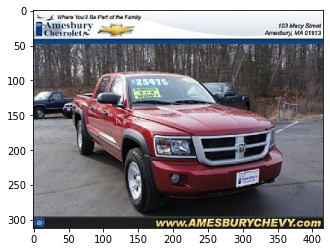

In [ ]:
plt.imshow(load_car_image(image_1))

In [ ]:
#Let us check its corresponding class
cars_train_data.iloc[0,:]['class']

'Dodge Dakota Crew Cab 2010'

(194, 259, 3)


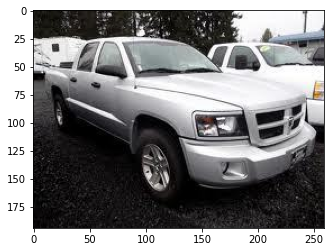

In [ ]:
plt.imshow(load_car_image(cars_train_data.iloc[1,:].imagePath))

In [ ]:
#Let us check its corresponding class
cars_train_data.iloc[1,:]['class']

'Dodge Dakota Crew Cab 2010'

(480, 640, 3)


'GMC Savana Van 2012'

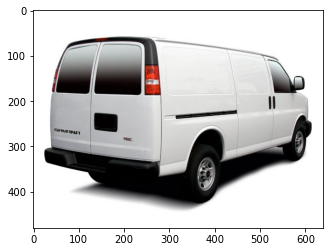

In [ ]:
plt.imshow(load_car_image(cars_train_data.iloc[8000,:].imagePath))
cars_train_data.iloc[8000,:]['class']

Total classes in Training Data set

In [ ]:
cars_train_data['class'].value_counts()

GMC Savana Van 2012                                    68
Chrysler 300 SRT-8 2010                                49
Mercedes-Benz 300-Class Convertible 1993               48
Mitsubishi Lancer Sedan 2012                           48
Chevrolet Corvette ZR1 2012                            47
                                                       ..
Rolls-Royce Phantom Drophead Coupe Convertible 2012    31
Chevrolet Express Cargo Van 2007                       30
Maybach Landaulet Convertible 2012                     29
FIAT 500 Abarth 2012                                   28
Hyundai Accent Sedan 2012                              24
Name: class, Length: 196, dtype: int64

In [ ]:
unique, counts = np.unique(cars_train_data['class'], return_counts=True)
unique, counts

(array(['AM General Hummer SUV 2000', 'Acura Integra Type R 2001',
        'Acura RL Sedan 2012', 'Acura TL Sedan 2012',
        'Acura TL Type-S 2008', 'Acura TSX Sedan 2012',
        'Acura ZDX Hatchback 2012',
        'Aston Martin V8 Vantage Convertible 2012',
        'Aston Martin V8 Vantage Coupe 2012',
        'Aston Martin Virage Convertible 2012',
        'Aston Martin Virage Coupe 2012', 'Audi 100 Sedan 1994',
        'Audi 100 Wagon 1994', 'Audi A5 Coupe 2012', 'Audi R8 Coupe 2012',
        'Audi RS 4 Convertible 2008', 'Audi S4 Sedan 2007',
        'Audi S4 Sedan 2012', 'Audi S5 Convertible 2012',
        'Audi S5 Coupe 2012', 'Audi S6 Sedan 2011',
        'Audi TT Hatchback 2011', 'Audi TT RS Coupe 2012',
        'Audi TTS Coupe 2012', 'Audi V8 Sedan 1994',
        'BMW 1 Series Convertible 2012', 'BMW 1 Series Coupe 2012',
        'BMW 3 Series Sedan 2012', 'BMW 3 Series Wagon 2012',
        'BMW 6 Series Convertible 2007', 'BMW ActiveHybrid 5 Sedan 2012',
        'BMW M3

We can see that training images has 8144 images. and has 196 classes.
Let us create the testing data set now.

In [ ]:
pathToTestData ='Dataset/Car Images/Test Images'

In [ ]:
#Importing the testing data set
cars_test_data = pd.DataFrame(columns=['imageName','imagePath','class','height','width'])

for dirname, _, filenames in os.walk(pathToTestData):
     for filename in filenames:
        path = os.path.join(dirname, filename)
        img_name = os.path.split(path)[1]
          
        if img_name!='.DS_Store':
          img = cv2.imread(path)
          height, width, channel = img.shape
          class_label = dirname.split('/')[-1]
          cars_test_data = cars_test_data.append({'imageName':img_name,'imagePath':path , 'class':class_label,'height':height,'width':width}, ignore_index = True)
       

In [ ]:
cars_test_data = cars_test_data[cars_test_data['class'] != 'Test Images']

In [ ]:
cars_test_data.to_csv(r'Dataset/cars_test_data.csv', index=False)
cars_test_data

,imageName,imagePath,class,height,width
0,00318.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,360,480
1,03773.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,194,259
2,01206.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,225,300
3,08018.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,768,1024
4,05448.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,225,300
...,...,...,...,...,...
8036,07450.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,221,300
8037,07518.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,194,259
8038,02893.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,492,786
8039,06161.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,194,259


In [ ]:
cars_test_data = pd.read_csv('Dataset/cars_test_data.csv')
cars_test_data

,imageName,imagePath,class,height,width
0,00318.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,360,480
1,03773.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,194,259
2,01206.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,225,300
3,08018.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,768,1024
4,05448.jpg,Dataset/Car Images/Test Images/Dodge Dakota Cr...,Dodge Dakota Crew Cab 2010,225,300
...,...,...,...,...,...
8036,07450.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,221,300
8037,07518.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,194,259
8038,02893.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,492,786
8039,06161.jpg,Dataset/Car Images/Test Images/Chevrolet Corve...,Chevrolet Corvette ZR1 2012,194,259


We can see that testing images has 8041 images.

We will sort, test and train images by image name.



In [ ]:
cars_train_data.sort_values(['imageName'],axis=0,ascending=[True],inplace=True)

cars_test_data.sort_values(['imageName'],axis=0,ascending=[True],inplace=True)

In [ ]:
#Renaming imageName to match to Annotations Data Set
cars_train_data.rename(columns = {'imageName': 'Image Name'},inplace = True)
cars_test_data.rename(columns = {'imageName': 'Image Name'},inplace = True)

In [ ]:
cars_train_data

,Image Name,imagePath,class,height,width
4114,00001.jpg,Dataset/Car Images/Train Images/Audi TTS Coupe...,Audi TTS Coupe 2012,400,600
6607,00002.jpg,Dataset/Car Images/Train Images/Acura TL Sedan...,Acura TL Sedan 2012,675,900
1760,00003.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Club Cab 2007,480,640
1596,00004.jpg,Dataset/Car Images/Train Images/Hyundai Sonata...,Hyundai Sonata Hybrid Sedan 2012,1386,2100
6564,00005.jpg,Dataset/Car Images/Train Images/Ford F-450 Sup...,Ford F-450 Super Duty Crew Cab 2012,108,144
...,...,...,...,...,...
2973,08140.jpg,Dataset/Car Images/Train Images/Chrysler Town ...,Chrysler Town and Country Minivan 2012,360,424
5781,08141.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,600,800
6804,08142.jpg,Dataset/Car Images/Train Images/Mercedes-Benz ...,Mercedes-Benz SL-Class Coupe 2009,469,750
6239,08143.jpg,Dataset/Car Images/Train Images/Ford GT Coupe ...,Ford GT Coupe 2006,1067,1600


In [ ]:
cars_test_data

,Image Name,imagePath,class,height,width
4541,00001.jpg,Dataset/Car Images/Test Images/Suzuki Aerio Se...,Suzuki Aerio Sedan 2007,182,276
3232,00002.jpg,Dataset/Car Images/Test Images/Ferrari 458 Ita...,Ferrari 458 Italia Convertible 2012,360,640
5276,00003.jpg,Dataset/Car Images/Test Images/Jeep Patriot SU...,Jeep Patriot SUV 2012,741,1024
2521,00004.jpg,Dataset/Car Images/Test Images/Toyota Camry Se...,Toyota Camry Sedan 2012,480,640
7832,00005.jpg,Dataset/Car Images/Test Images/Tesla Model S S...,Tesla Model S Sedan 2012,373,600
...,...,...,...,...,...
4350,08037.jpg,Dataset/Car Images/Test Images/Chevrolet Sonic...,Chevrolet Sonic Sedan 2012,800,1200
3123,08038.jpg,Dataset/Car Images/Test Images/Audi V8 Sedan 1...,Audi V8 Sedan 1994,480,640
2145,08039.jpg,Dataset/Car Images/Test Images/Audi 100 Sedan ...,Audi 100 Sedan 1994,303,635
3953,08040.jpg,Dataset/Car Images/Test Images/BMW Z4 Converti...,BMW Z4 Convertible 2012,427,640


Let us load the annotations now.

In [ ]:
#Loading Training Annotations
pathToAnotations ='Dataset/Annotations'
cars_train_annotations = pd.read_csv(pathToAnotations+'/Train Annotations.csv')

In [ ]:
cars_train_annotations

,Image Name,Bounding Box coordinates,Unnamed: 2,Unnamed: 3,Unnamed: 4,Image class
0,00001.jpg,39,116,569,375,14
1,00002.jpg,36,116,868,587,3
2,00003.jpg,85,109,601,381,91
3,00004.jpg,621,393,1484,1096,134
4,00005.jpg,14,36,133,99,106
...,...,...,...,...,...,...
8139,08140.jpg,3,44,423,336,78
8140,08141.jpg,138,150,706,523,196
8141,08142.jpg,26,246,660,449,163
8142,08143.jpg,78,526,1489,908,112


We can see that the training annotations have bounding box coordinates of all the 8144 images.

In [ ]:
#Loading Testing Annotations
pathToAnotations ='Dataset/Annotations'
cars_test_annotations = pd.read_csv(pathToAnotations+'/Test Annotation.csv')

In [ ]:
cars_test_annotations

,Image Name,Bounding Box coordinates,Unnamed: 2,Unnamed: 3,Unnamed: 4,Image class
0,00001.jpg,30,52,246,147,181
1,00002.jpg,100,19,576,203,103
2,00003.jpg,51,105,968,659,145
3,00004.jpg,67,84,581,407,187
4,00005.jpg,140,151,593,339,185
...,...,...,...,...,...,...
8036,08037.jpg,49,57,1169,669,63
8037,08038.jpg,23,18,640,459,16
8038,08039.jpg,33,27,602,252,17
8039,08040.jpg,33,142,521,376,38


We can see that the testing annotations have bounding box coordinates of all the 8041 images.

We can see that the annotations dataset has Unamed columns for bounding box coordinates, let us assume it is in the sequence of x1,x2,y1 and y2 and visualize one image to verify it.

Mapping Train and Test images to its annotations and classes now.

In [ ]:
car_train_image_details = pd.merge(cars_train_data, cars_train_annotations, 
                   on='Image Name', 
                   how='outer')

In [ ]:
car_train_image_details

,Image Name,imagePath,class,height,width,Bounding Box coordinates,Unnamed: 2,Unnamed: 3,Unnamed: 4,Image class
0,00001.jpg,Dataset/Car Images/Train Images/Audi TTS Coupe...,Audi TTS Coupe 2012,400,600,39,116,569,375,14
1,00002.jpg,Dataset/Car Images/Train Images/Acura TL Sedan...,Acura TL Sedan 2012,675,900,36,116,868,587,3
2,00003.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Club Cab 2007,480,640,85,109,601,381,91
3,00004.jpg,Dataset/Car Images/Train Images/Hyundai Sonata...,Hyundai Sonata Hybrid Sedan 2012,1386,2100,621,393,1484,1096,134
4,00005.jpg,Dataset/Car Images/Train Images/Ford F-450 Sup...,Ford F-450 Super Duty Crew Cab 2012,108,144,14,36,133,99,106
...,...,...,...,...,...,...,...,...,...,...
8139,08140.jpg,Dataset/Car Images/Train Images/Chrysler Town ...,Chrysler Town and Country Minivan 2012,360,424,3,44,423,336,78
8140,08141.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,600,800,138,150,706,523,196
8141,08142.jpg,Dataset/Car Images/Train Images/Mercedes-Benz ...,Mercedes-Benz SL-Class Coupe 2009,469,750,26,246,660,449,163
8142,08143.jpg,Dataset/Car Images/Train Images/Ford GT Coupe ...,Ford GT Coupe 2006,1067,1600,78,526,1489,908,112


We can see that train images are mapped to its classes and annotations. 

We will rename Unnamed columns to X1,Y1, X2, Y2 accordingly.

In [ ]:
car_train_image_details.rename(columns = {'Bounding Box coordinates': 'X1','Unnamed: 2':'Y1','Unnamed: 3':'X2','Unnamed: 4':'Y2'},inplace = True)


In [ ]:
car_train_image_details

,Image Name,imagePath,class,height,width,X1,Y1,X2,Y2,Image class
0,00001.jpg,Dataset/Car Images/Train Images/Audi TTS Coupe...,Audi TTS Coupe 2012,400,600,39,116,569,375,14
1,00002.jpg,Dataset/Car Images/Train Images/Acura TL Sedan...,Acura TL Sedan 2012,675,900,36,116,868,587,3
2,00003.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Club Cab 2007,480,640,85,109,601,381,91
3,00004.jpg,Dataset/Car Images/Train Images/Hyundai Sonata...,Hyundai Sonata Hybrid Sedan 2012,1386,2100,621,393,1484,1096,134
4,00005.jpg,Dataset/Car Images/Train Images/Ford F-450 Sup...,Ford F-450 Super Duty Crew Cab 2012,108,144,14,36,133,99,106
...,...,...,...,...,...,...,...,...,...,...
8139,08140.jpg,Dataset/Car Images/Train Images/Chrysler Town ...,Chrysler Town and Country Minivan 2012,360,424,3,44,423,336,78
8140,08141.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,600,800,138,150,706,523,196
8141,08142.jpg,Dataset/Car Images/Train Images/Mercedes-Benz ...,Mercedes-Benz SL-Class Coupe 2009,469,750,26,246,660,449,163
8142,08143.jpg,Dataset/Car Images/Train Images/Ford GT Coupe ...,Ford GT Coupe 2006,1067,1600,78,526,1489,908,112


In [ ]:
car_train_image_details['Image class'].value_counts()

119    68
79     49
161    48
167    48
144    47
       ..
175    31
64     30
158    29
99     28
136    24
Name: Image class, Length: 196, dtype: int64

In [ ]:
car_train_image_details['class'].value_counts()

GMC Savana Van 2012                                    68
Chrysler 300 SRT-8 2010                                49
Mercedes-Benz 300-Class Convertible 1993               48
Mitsubishi Lancer Sedan 2012                           48
Chevrolet Corvette ZR1 2012                            47
                                                       ..
Rolls-Royce Phantom Drophead Coupe Convertible 2012    31
Chevrolet Express Cargo Van 2007                       30
Maybach Landaulet Convertible 2012                     29
FIAT 500 Abarth 2012                                   28
Hyundai Accent Sedan 2012                              24
Name: class, Length: 196, dtype: int64

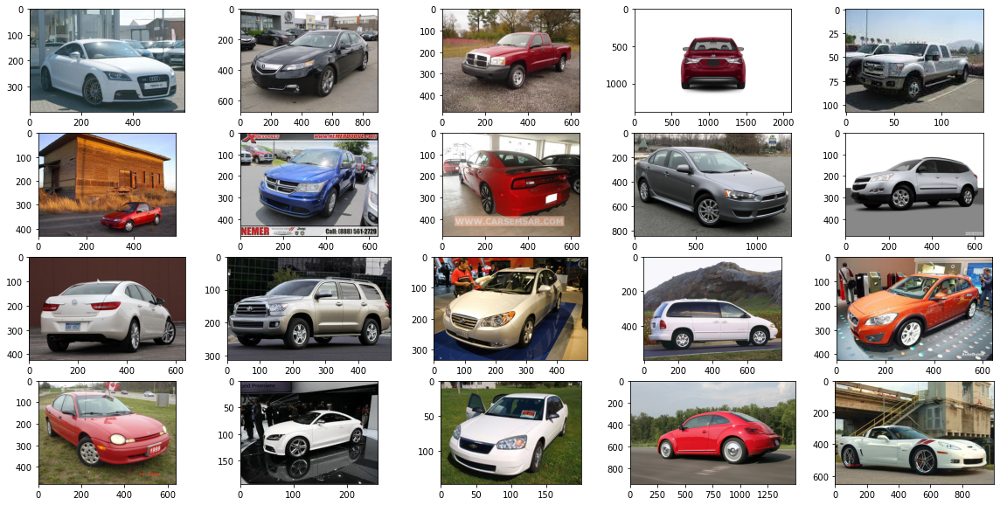

In [ ]:
# Visualizing train images
plt.figure(figsize=(20,10)) 
for i in range(20):
    plt.subplot(4, 5, i + 1) 
    plt.imshow(plt.imread(car_train_image_details['imagePath'][i]))

Now Let us visualize train images with its bounding box.

In [ ]:
def display_image_with_bounding_box(imageDetails):
    imagePath=imageDetails.imagePath
    img_arr = cv2.imread(imagePath)
    cv2.rectangle(img_arr, (imageDetails.X1, imageDetails.Y1), (imageDetails.X2, imageDetails.Y2), (255, 0, 0), 3)
    plt.imshow(img_arr)
    print(imageDetails['class'])
    

Buick Verano Sedan 2012


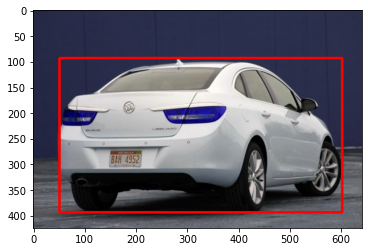

In [ ]:
display_image_with_bounding_box(car_train_image_details.iloc[10,:])

Plymouth Neon Coupe 1999


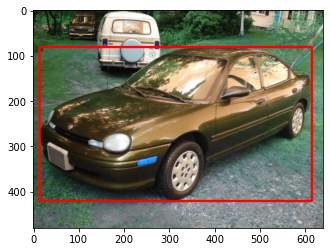

In [ ]:
display_image_with_bounding_box(car_train_image_details.iloc[3333,:])

Audi 100 Sedan 1994


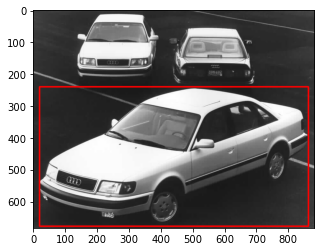

In [ ]:
display_image_with_bounding_box(car_train_image_details.iloc[8143,:])

Audi TTS Coupe 2012
Acura TL Sedan 2012
Dodge Dakota Club Cab 2007
Hyundai Sonata Hybrid Sedan 2012
Ford F-450 Super Duty Crew Cab 2012
Geo Metro Convertible 1993
Dodge Journey SUV 2012
Dodge Charger Sedan 2012
Mitsubishi Lancer Sedan 2012
Chevrolet Traverse SUV 2012
Buick Verano Sedan 2012
Toyota Sequoia SUV 2012
Hyundai Elantra Sedan 2007
Dodge Caravan Minivan 1997
Volvo C30 Hatchback 2012
Plymouth Neon Coupe 1999
Audi TTS Coupe 2012
Chevrolet Malibu Sedan 2007
Volkswagen Beetle Hatchback 2012
Chevrolet Corvette Ron Fellows Edition Z06 2007


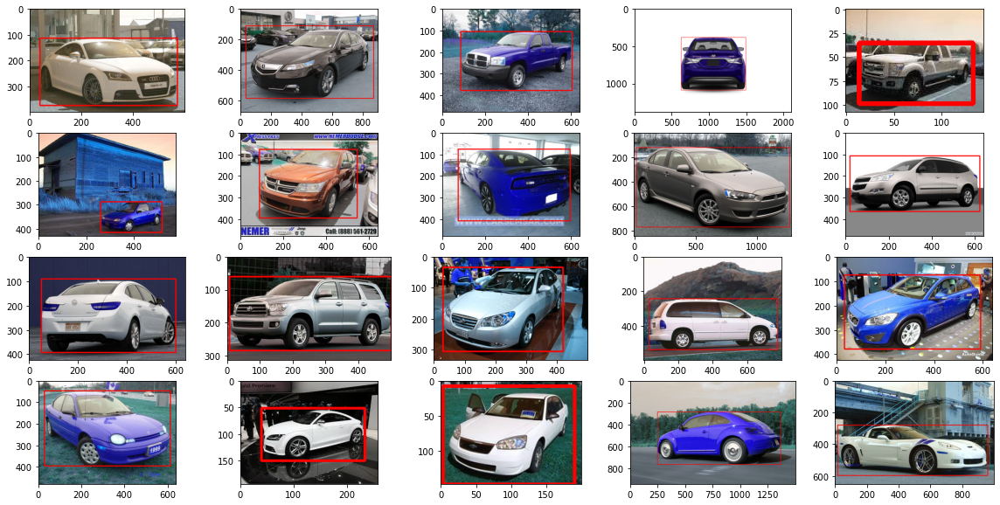

In [ ]:
# Visualizing First 20 train images with bounding boxes
plt.figure(figsize=(20,10)) 
for i in range(20):
    plt.subplot(4, 5, i + 1) 
    display_image_with_bounding_box(car_train_image_details.iloc[i,:])

In [ ]:
car_test_image_details = pd.merge(cars_test_data, cars_test_annotations, 
                   on='Image Name', 
                   how='outer')

In [ ]:
car_test_image_details

,Image Name,imagePath,class,height,width,Bounding Box coordinates,Unnamed: 2,Unnamed: 3,Unnamed: 4,Image class
0,00001.jpg,Dataset/Car Images/Test Images/Suzuki Aerio Se...,Suzuki Aerio Sedan 2007,182,276,30,52,246,147,181
1,00002.jpg,Dataset/Car Images/Test Images/Ferrari 458 Ita...,Ferrari 458 Italia Convertible 2012,360,640,100,19,576,203,103
2,00003.jpg,Dataset/Car Images/Test Images/Jeep Patriot SU...,Jeep Patriot SUV 2012,741,1024,51,105,968,659,145
3,00004.jpg,Dataset/Car Images/Test Images/Toyota Camry Se...,Toyota Camry Sedan 2012,480,640,67,84,581,407,187
4,00005.jpg,Dataset/Car Images/Test Images/Tesla Model S S...,Tesla Model S Sedan 2012,373,600,140,151,593,339,185
...,...,...,...,...,...,...,...,...,...,...
8036,08037.jpg,Dataset/Car Images/Test Images/Chevrolet Sonic...,Chevrolet Sonic Sedan 2012,800,1200,49,57,1169,669,63
8037,08038.jpg,Dataset/Car Images/Test Images/Audi V8 Sedan 1...,Audi V8 Sedan 1994,480,640,23,18,640,459,16
8038,08039.jpg,Dataset/Car Images/Test Images/Audi 100 Sedan ...,Audi 100 Sedan 1994,303,635,33,27,602,252,17
8039,08040.jpg,Dataset/Car Images/Test Images/BMW Z4 Converti...,BMW Z4 Convertible 2012,427,640,33,142,521,376,38


In [ ]:
#Renaming unnamed columns
car_test_image_details.rename(columns = {'Bounding Box coordinates': 'X1','Unnamed: 2':'Y1','Unnamed: 3':'X2','Unnamed: 4':'Y2'},inplace = True)


In [ ]:
car_test_image_details['Image class'].value_counts()

119    68
161    48
79     48
167    47
20     46
       ..
175    30
64     29
158    29
99     27
136    24
Name: Image class, Length: 196, dtype: int64

In [ ]:
car_test_image_details['class'].value_counts()

GMC Savana Van 2012                                    68
Mercedes-Benz 300-Class Convertible 1993               48
Chrysler 300 SRT-8 2010                                48
Mitsubishi Lancer Sedan 2012                           47
Audi S6 Sedan 2011                                     46
                                                       ..
Rolls-Royce Phantom Drophead Coupe Convertible 2012    30
Maybach Landaulet Convertible 2012                     29
Chevrolet Express Cargo Van 2007                       29
FIAT 500 Abarth 2012                                   27
Hyundai Accent Sedan 2012                              24
Name: class, Length: 196, dtype: int64

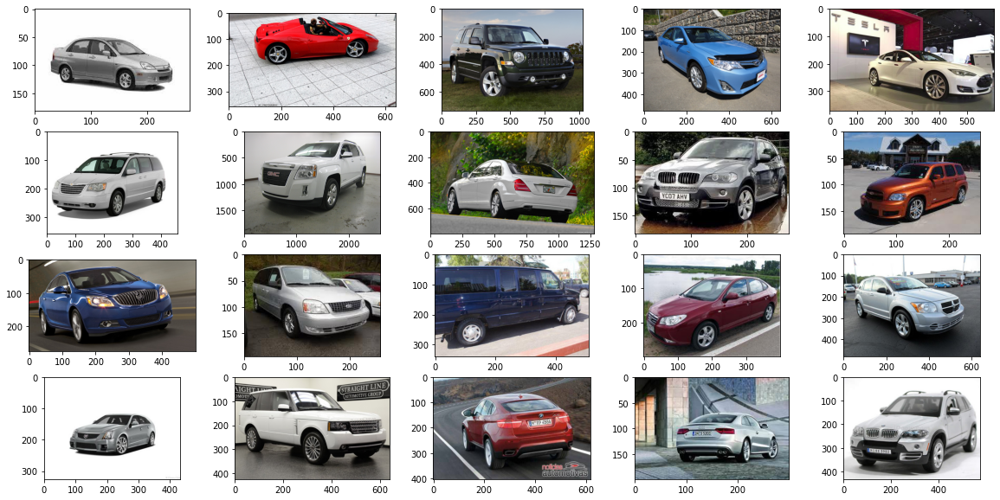

In [ ]:
# Visualizing test images
plt.figure(figsize=(20,10)) 
for i in range(20):
    plt.subplot(4, 5, i + 1) 
    plt.imshow(plt.imread(car_test_image_details['imagePath'][i]))

We can see that train images are mapped to its classes and annotations. Let us visualize 5 test images with its bounding box.

Suzuki Aerio Sedan 2007


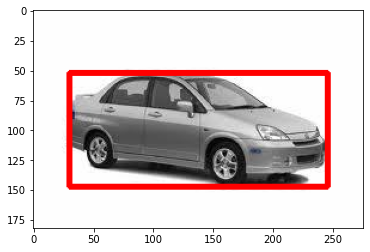

In [ ]:
display_image_with_bounding_box(car_test_image_details.iloc[0,:])

Buick Verano Sedan 2012


(None,)

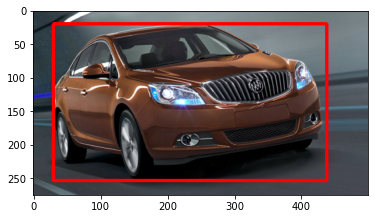

In [ ]:
display_image_with_bounding_box(car_test_image_details.iloc[10,:]), 

Mercedes-Benz S-Class Sedan 2012


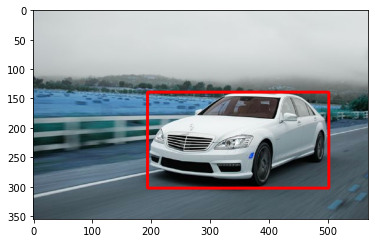

In [ ]:
display_image_with_bounding_box(car_test_image_details.iloc[3000,:])

Hyundai Veloster Hatchback 2012


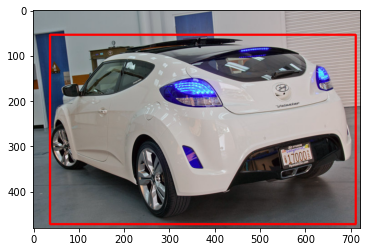

In [ ]:
display_image_with_bounding_box(car_test_image_details.iloc[8000,:])

BMW X5 SUV 2007


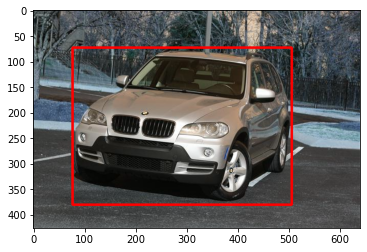

In [ ]:
display_image_with_bounding_box(car_test_image_details.iloc[8040,:])

Suzuki Aerio Sedan 2007
Ferrari 458 Italia Convertible 2012
Jeep Patriot SUV 2012
Toyota Camry Sedan 2012
Tesla Model S Sedan 2012
Chrysler Town and Country Minivan 2012
GMC Terrain SUV 2012
Mercedes-Benz S-Class Sedan 2012
BMW X5 SUV 2007
Chevrolet HHR SS 2010
Buick Verano Sedan 2012
Ford Freestar Minivan 2007
Ford E-Series Wagon Van 2012
Hyundai Elantra Sedan 2007
Dodge Caliber Wagon 2012
Cadillac CTS-V Sedan 2012
Land Rover Range Rover SUV 2012
BMW X6 SUV 2012
Audi S5 Coupe 2012
BMW X5 SUV 2007


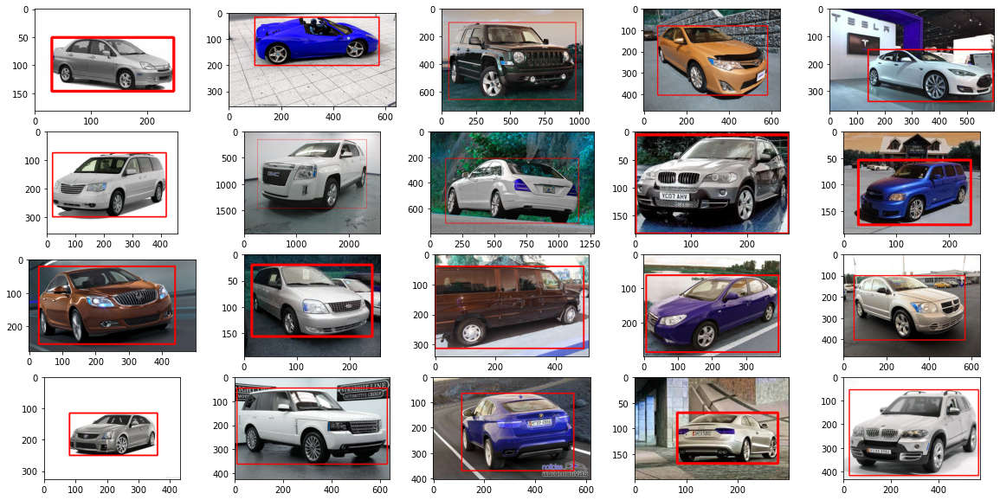

In [ ]:
# Visualizing First 20 test images with bounding boxes
plt.figure(figsize=(20,10)) 
for i in range(20):
    plt.subplot(4, 5, i + 1) 
    display_image_with_bounding_box(car_test_image_details.iloc[i,:])

### EDA and Data Visualizations
Importing Car names.

In [ ]:
car_labels_data = pd.read_csv('Dataset/Car names and make.csv',header=None,names =['labels'])
car_labels_data

,labels
0,AM General Hummer SUV 2000
1,Acura RL Sedan 2012
2,Acura TL Sedan 2012
3,Acura TL Type-S 2008
4,Acura TSX Sedan 2012
...,...
191,Volkswagen Beetle Hatchback 2012
192,Volvo C30 Hatchback 2012
193,Volvo 240 Sedan 1993
194,Volvo XC90 SUV 2007


In [ ]:
print('Found one Class name: Ram C/V Cargo Van Minivan 2012, not in sync with directory path, renaming it')
car_labels_data['labels'].replace({"Ram C/V Cargo Van Minivan 2012": "Ram C-V Cargo Van Minivan 2012"}, inplace=True)

Found one Class name: Ram C/V Cargo Van Minivan 2012, not in sync with directory path, renaming it


In [ ]:
car_labels_data.sort_values(['labels'], 
                    axis=0,
                    ascending=[True], 
                    inplace=True)
car_labels_data = car_labels_data.reset_index()

In [ ]:
car_labels_data['year'] = car_labels_data['labels'].str[-4:]
car_labels_data['labels'] = car_labels_data['labels'].apply(lambda x:x[:-4])

In [ ]:
car_labels_data

,index,labels,year
0,0,AM General Hummer SUV,2000
1,5,Acura Integra Type R,2001
2,1,Acura RL Sedan,2012
3,2,Acura TL Sedan,2012
4,3,Acura TL Type-S,2008
...,...,...,...
191,189,Volkswagen Golf Hatchback,2012
192,193,Volvo 240 Sedan,1993
193,192,Volvo C30 Hatchback,2012
194,194,Volvo XC90 SUV,2007


In [ ]:
# Function which returns last word
def lastWord(string):
   
    # split by space and converting
    # string to list and
    lis = list(string.split(" "))
     
    # length of list
    length = len(lis)
     
    # returning last element in list
    last_word= lis[length-2]
    if(last_word == 'R'):
        last_word='Type R'
    return last_word


In [ ]:
lastWord(car_labels_data.iloc[0,:].labels)

'SUV'

In [ ]:
lastWord(car_labels_data.iloc[1,:].labels)

'Type R'

In [ ]:
car_labels_data['type'] = car_labels_data['labels'].apply(lambda x:lastWord(x))

In [ ]:
car_labels_data

,index,labels,year,type
0,0,AM General Hummer SUV,2000,SUV
1,5,Acura Integra Type R,2001,Type R
2,1,Acura RL Sedan,2012,Sedan
3,2,Acura TL Sedan,2012,Sedan
4,3,Acura TL Type-S,2008,Type-S
...,...,...,...,...
191,189,Volkswagen Golf Hatchback,2012,Hatchback
192,193,Volvo 240 Sedan,1993,Sedan
193,192,Volvo C30 Hatchback,2012,Hatchback
194,194,Volvo XC90 SUV,2007,SUV


In [ ]:
car_labels_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 196 entries, 0 to 195
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   index   196 non-null    int64 
 1   labels  196 non-null    object
 2   year    196 non-null    object
 3   type    196 non-null    object
dtypes: int64(1), object(3)
memory usage: 6.2+ KB


In [ ]:
car_labels_data.type.value_counts()

Sedan           46
SUV             34
Convertible     26
Coupe           25
Cab             17
Hatchback       13
Van              7
Minivan          6
Wagon            6
SS               3
SRT-8            2
Z06              1
SuperCab         1
GS               1
Type-S           1
Superleggera     1
SRT8             1
Abarth           1
Type R           1
ZR1              1
IPL              1
XKR              1
Name: type, dtype: int64

In [ ]:
car_labels_data.labels.value_counts()

Bentley Continental GT Coupe                   2
Volkswagen Golf Hatchback                      2
Ford F-150 Regular Cab                         2
Dodge Durango SUV                              2
Honda Odyssey Minivan                          2
                                              ..
BMW 1 Series Convertible                       1
Dodge Challenger SRT8                          1
GMC Acadia SUV                                 1
Lamborghini Gallardo LP 570-4 Superleggera     1
Infiniti G Coupe IPL                           1
Name: labels, Length: 189, dtype: int64

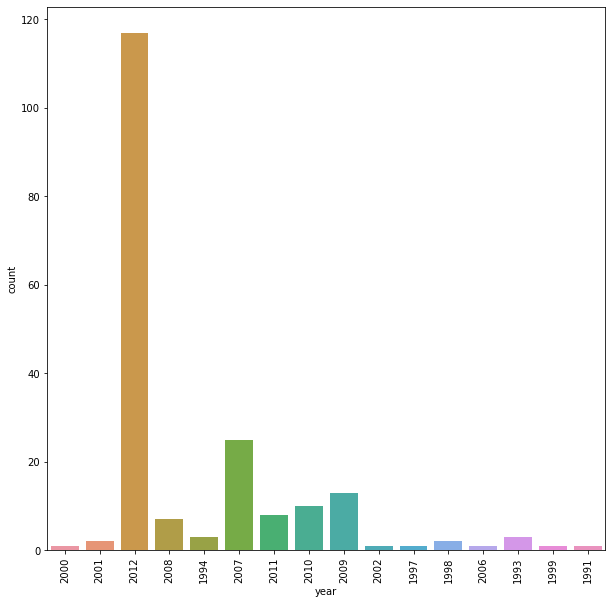

In [ ]:
plt.figure(figsize=(10,10))
sns.countplot(x='year',data=car_labels_data)
plt.yticks(rotation = 0)
plt.xticks(rotation = 90)
plt.show()

<AxesSubplot:xlabel='type', ylabel='count'>

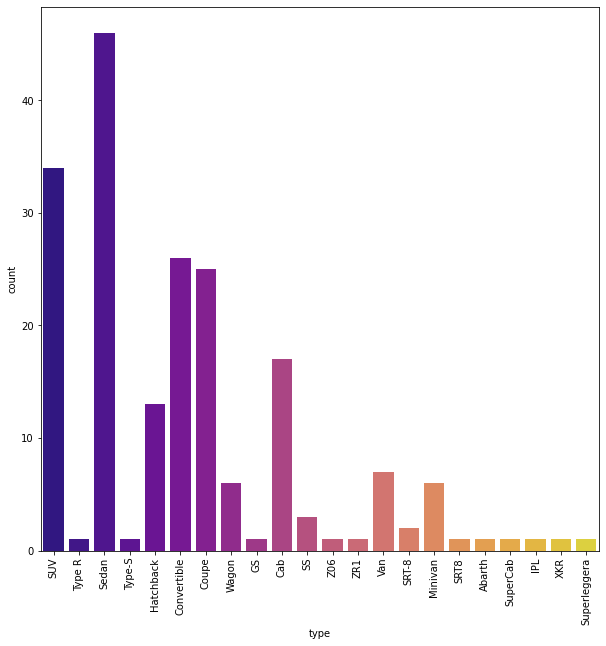

In [ ]:
plt.figure(figsize=(10,10))
plt.xticks(rotation='vertical')
sns.countplot(data=car_labels_data, x='type', palette='plasma')

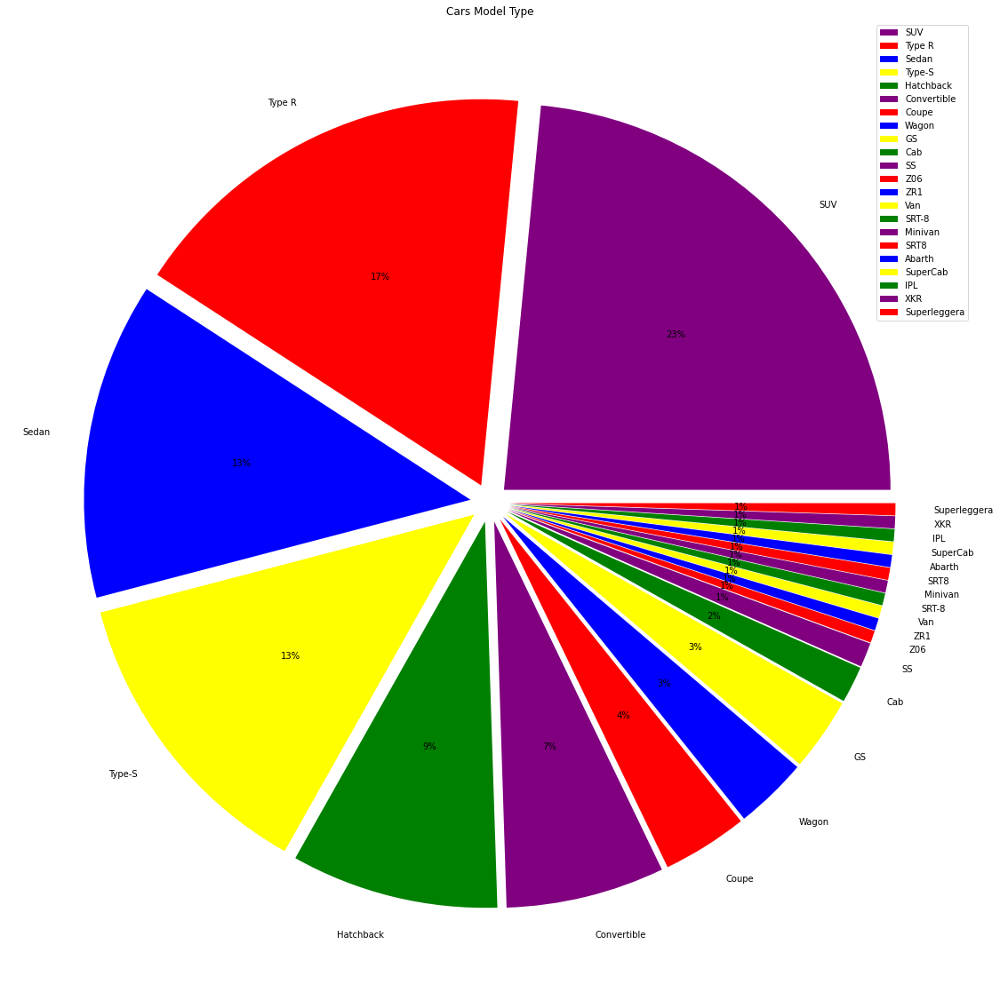

In [ ]:
fig, (ax1) = plt.subplots(ncols=1, figsize=(20, 20))

df_car_model_type = pd.DataFrame(car_labels_data['type'].value_counts()).reset_index()
df_car_model_type.columns = ['Car Model Type', 'count']

colors = ['purple', 'red', 'blue', 'yellow', 'green']
labels = car_labels_data['type'].unique()
type_count = car_labels_data['type'].nunique()

ax1.pie(df_car_model_type['count'], labels = labels, colors=colors, explode=[0.05]*type_count, autopct='%.0f%%')
ax1.set_title('Cars Model Type')
ax1.legend(labels, loc = 'upper right')


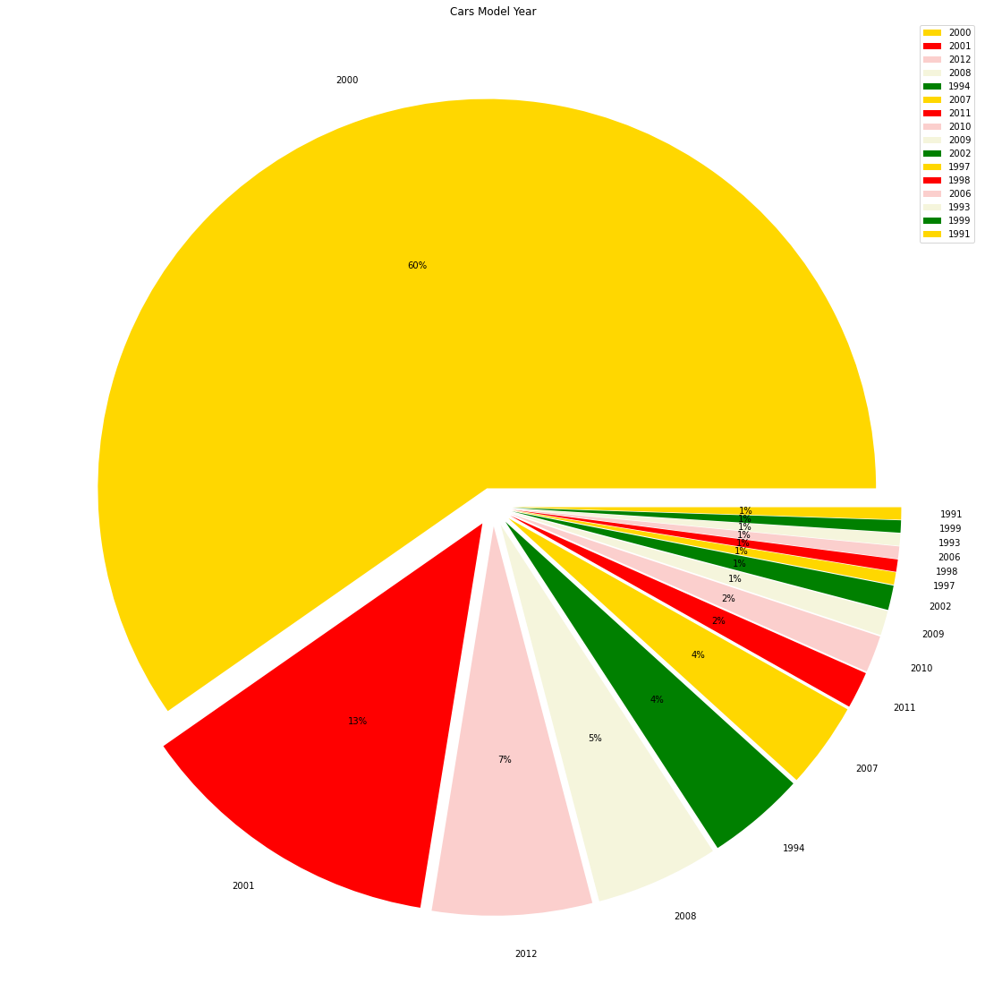

In [ ]:
fig, (ax1) = plt.subplots(ncols=1, figsize=(20, 20))

df_car_model_year = pd.DataFrame(car_labels_data['year'].value_counts()).reset_index()
df_car_model_year.columns = ['Car Model Year', 'count']

colors = ['gold', 'red', '#FBCFCD', '#F5F5DC', 'green']
labels = car_labels_data['year'].unique()
year_count = car_labels_data['year'].nunique()

ax1.pie(df_car_model_year['count'], labels = labels, colors=colors, explode=[0.05]*year_count, autopct='%.0f%%')
ax1.set_title('Cars Model Year')
ax1.legend(labels, loc = 'upper right')



<AxesSubplot:xlabel='year', ylabel='type'>

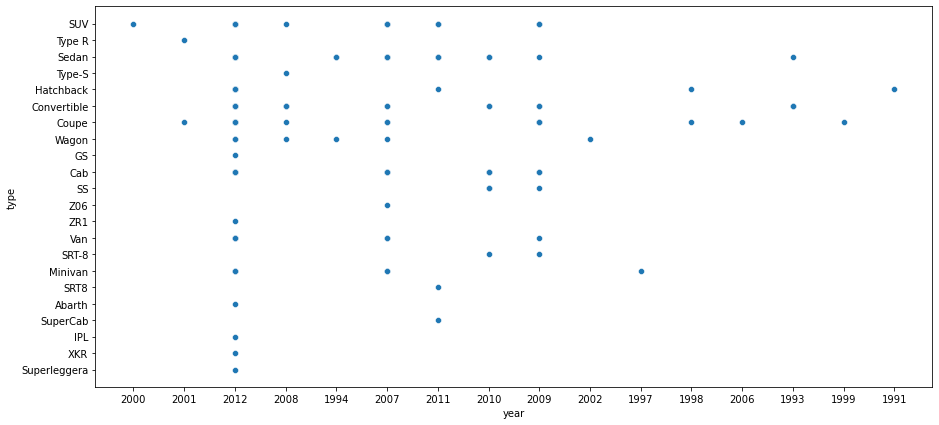

In [ ]:
figure = plt.figure(figsize=(15,7))
sns.scatterplot(x='year', y='type', data=car_labels_data)

<AxesSubplot:xlabel='year', ylabel='type'>

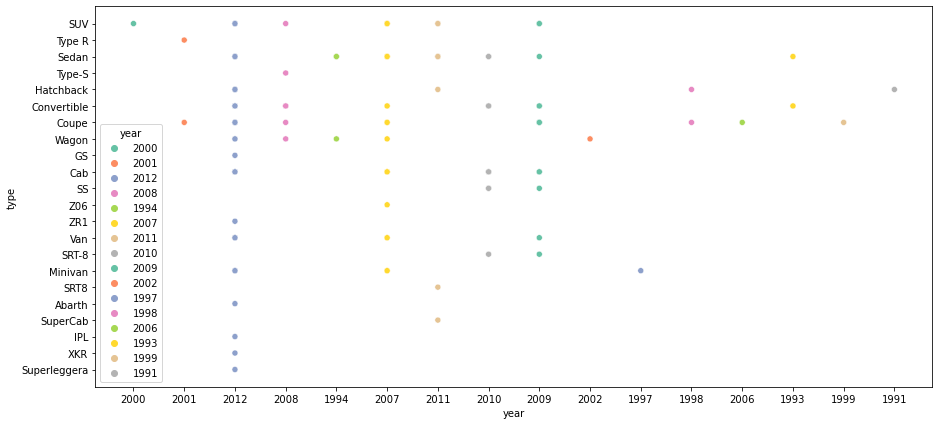

In [ ]:
figure = plt.figure(figsize=(15,7))
sns.scatterplot(car_labels_data['year'], car_labels_data['type'], hue=car_labels_data['year'], palette='Set2') 

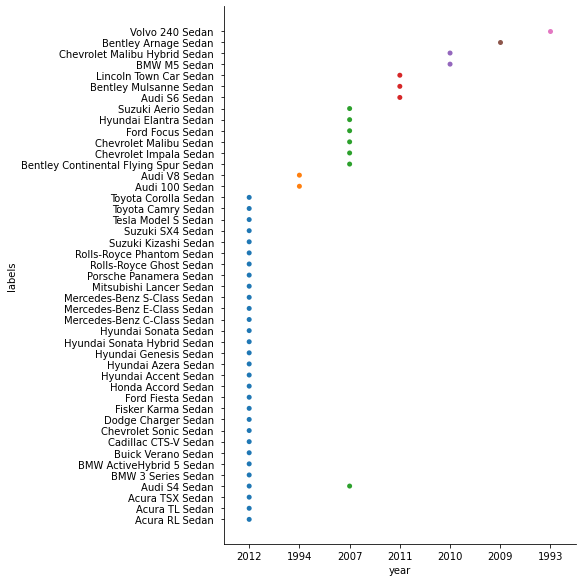

In [ ]:
# filtering the rows for Sedan
df=car_labels_data[car_labels_data['labels'].str.contains('Sedan')]
sns.catplot(y="labels", x="year", data=df,kind="swarm",height=8, aspect=1)

<AxesSubplot:xlabel='labels', ylabel='count'>

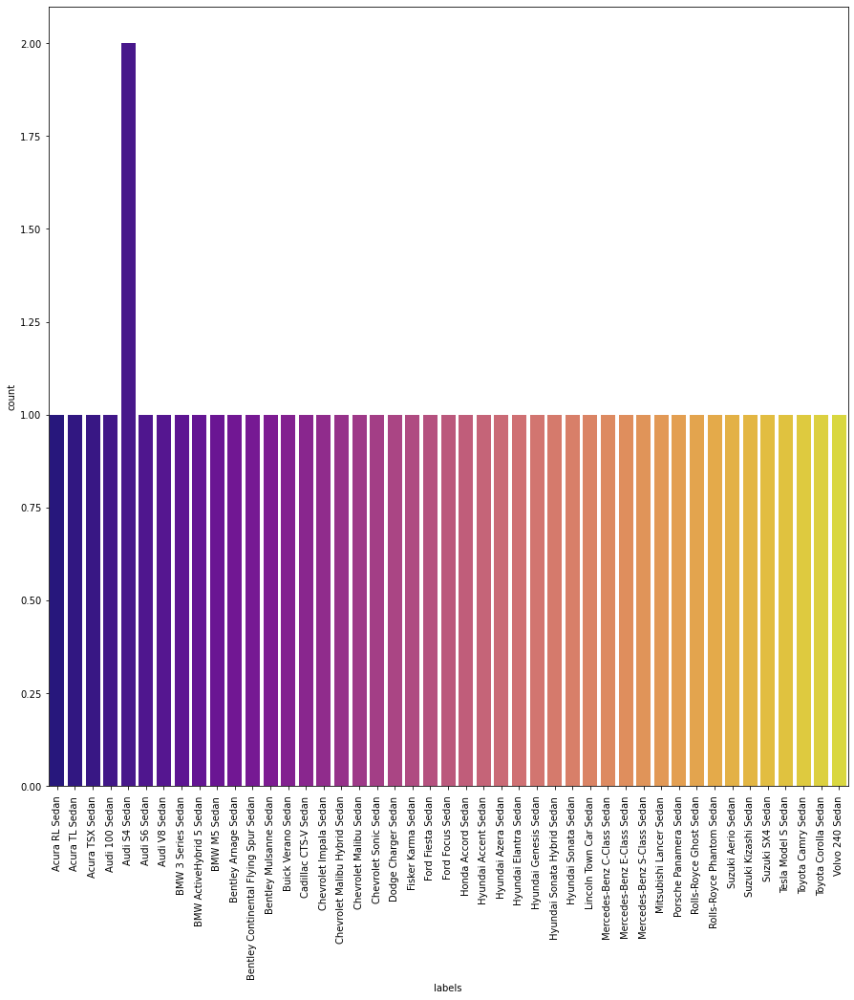

In [ ]:
figure = plt.figure(figsize=(15,15))
plt.xticks(rotation='vertical')
sns.countplot(data=df, x='labels',palette='plasma')

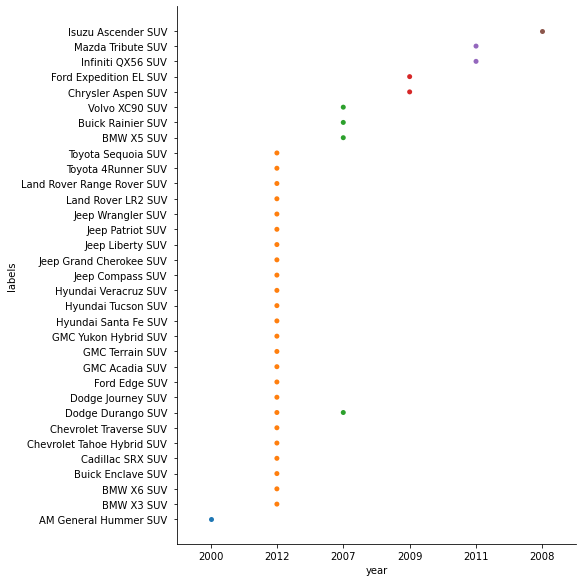

In [ ]:
# filtering the rows for SUV
df2=car_labels_data[car_labels_data['labels'].str.contains('SUV')]
sns.catplot(y="labels", x="year", data=df2,kind="swarm",height=8, aspect=1)

<AxesSubplot:xlabel='labels', ylabel='count'>

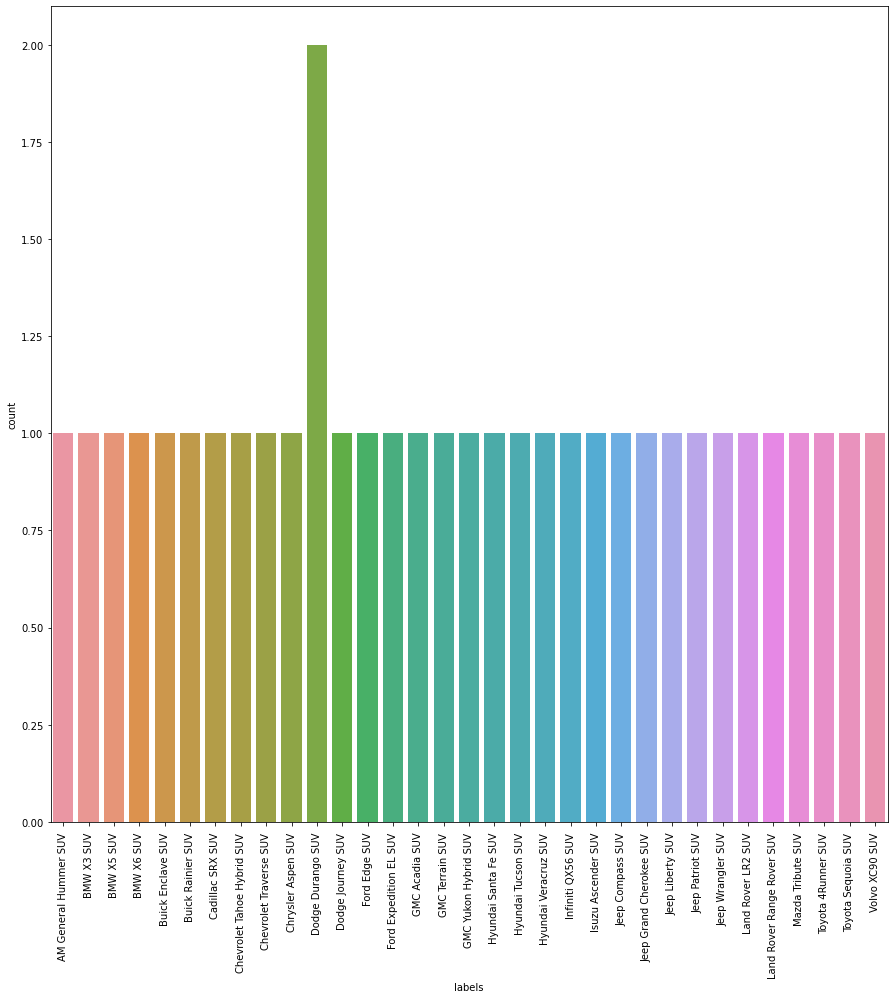

In [ ]:
figure = plt.figure(figsize=(15,15))
plt.xticks(rotation='vertical')
sns.countplot(data=df2, x='labels')

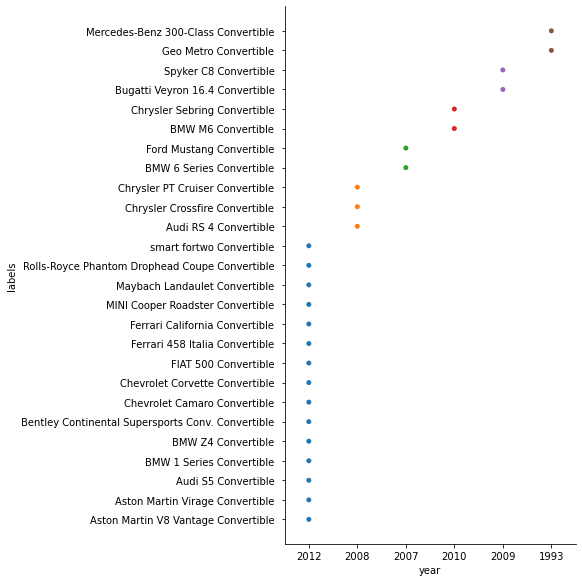

In [ ]:
# filtering the rows for Convertible
df3=car_labels_data[car_labels_data['labels'].str.contains('Convertible')]
sns.catplot(y="labels", x="year", data=df3,kind="swarm",height=8, aspect=1)

<AxesSubplot:xlabel='labels', ylabel='count'>

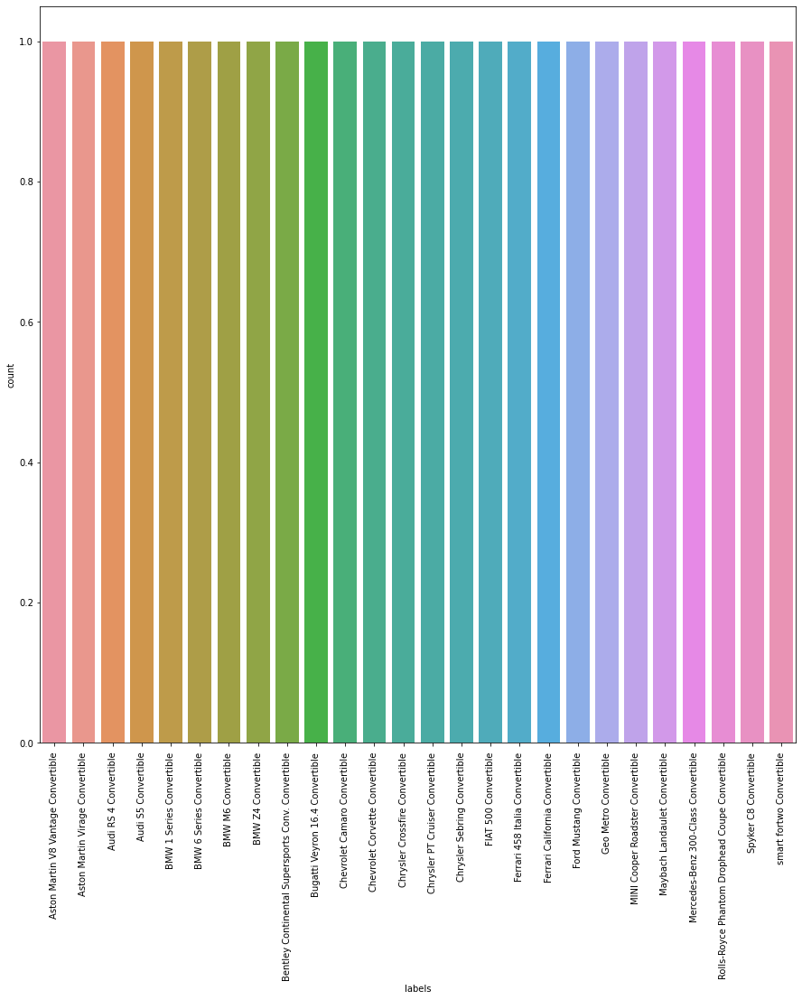

In [ ]:
figure = plt.figure(figsize=(15,15))
plt.xticks(rotation='vertical')
sns.countplot(data=df3, x='labels')

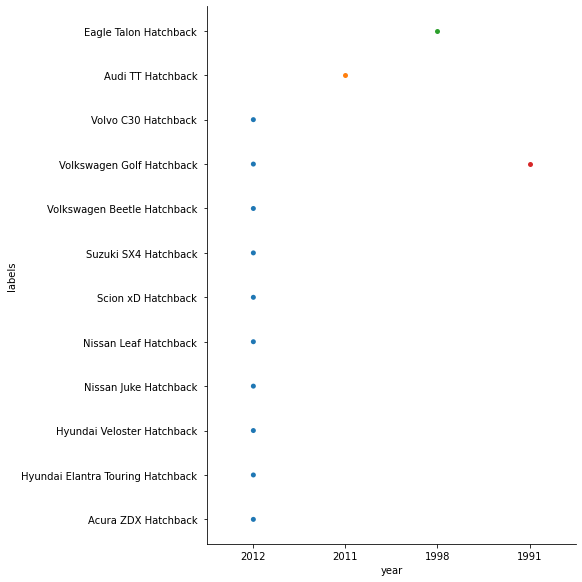

In [ ]:
# filtering the rows for Hatchback
df4=car_labels_data[car_labels_data['labels'].str.contains('Hatchback')]
sns.catplot(y="labels", x="year", data=df4,kind="swarm",height=8, aspect=1)

<AxesSubplot:xlabel='labels', ylabel='count'>

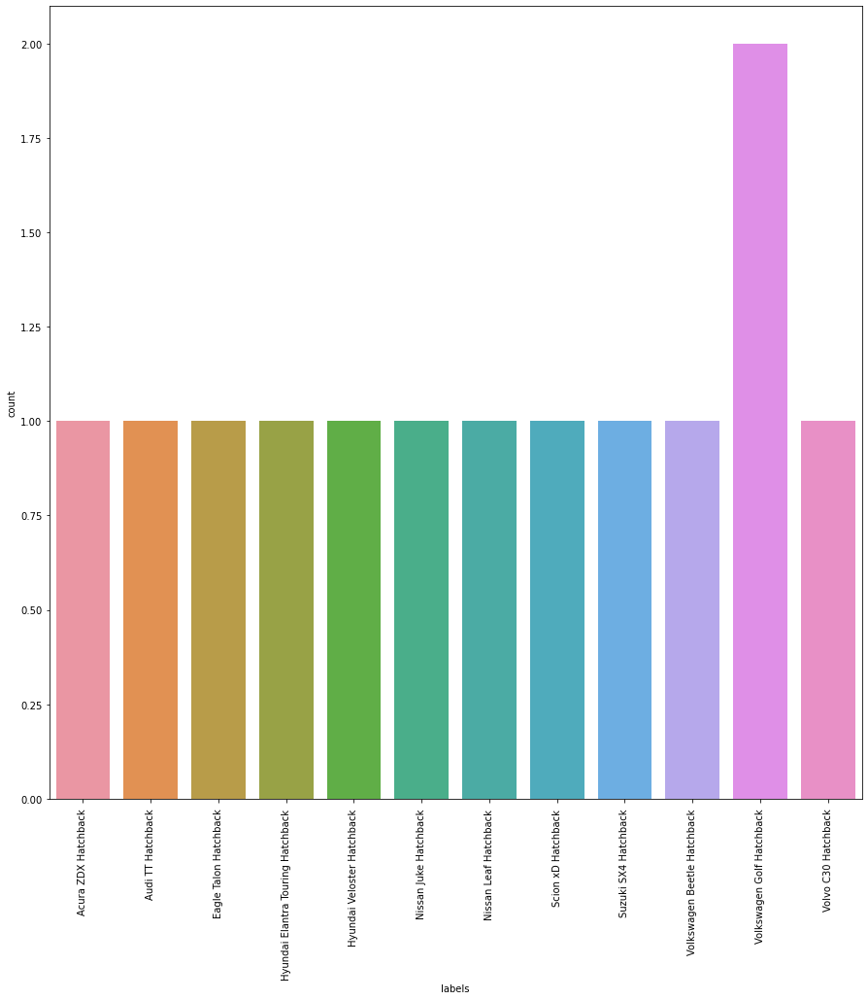

In [ ]:
figure = plt.figure(figsize=(15,15))
plt.xticks(rotation='vertical')
sns.countplot(data=df4, x='labels')

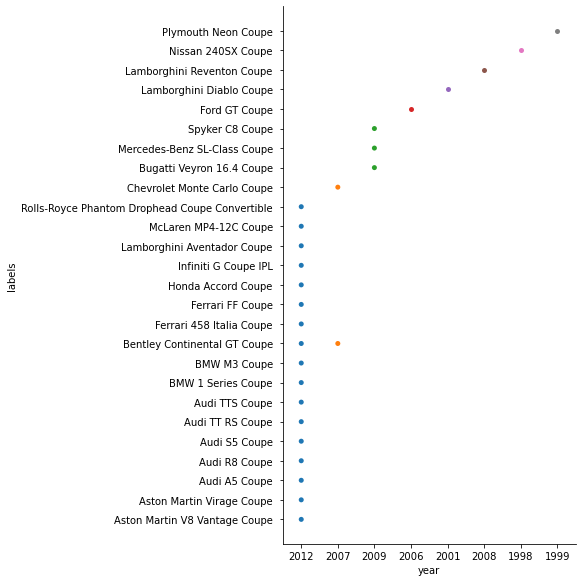

In [ ]:
# filtering the rows for Coupe
df5=car_labels_data[car_labels_data['labels'].str.contains('Coupe')]
sns.catplot(y="labels", x="year", data=df5,kind="swarm",height=8, aspect=1)

<AxesSubplot:xlabel='labels', ylabel='count'>

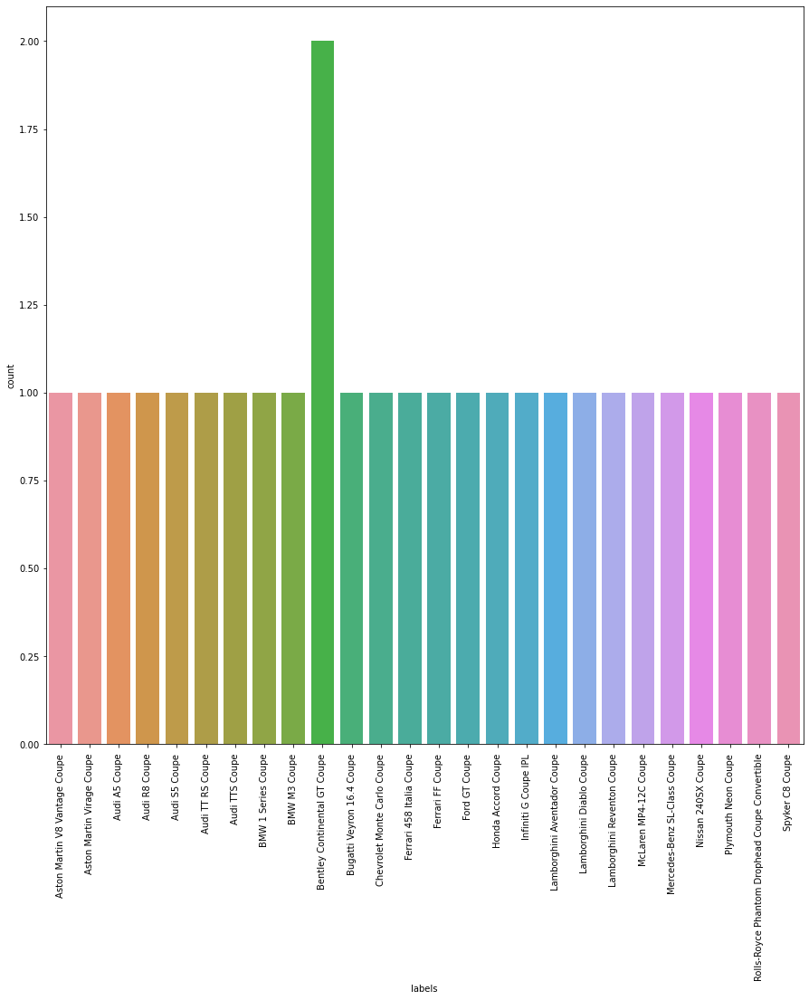

In [ ]:
figure = plt.figure(figsize=(15,15))
plt.xticks(rotation='vertical')
sns.countplot(data=df5, x='labels')

In [ ]:
text = " ".join(name for name in car_labels_data.labels)
print ("There are {} words in the combination of all records.".format(len(text)))

There are 4669 words in the combination of all records.


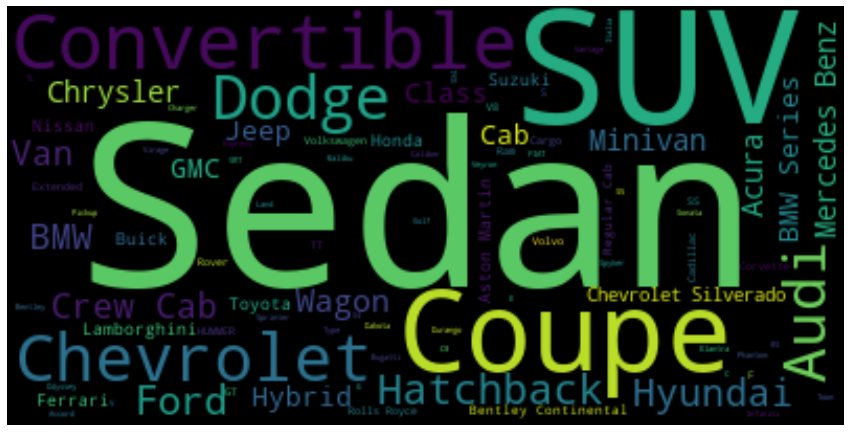

In [ ]:
from wordcloud import WordCloud
# Generate a word cloud image
wordcloud = WordCloud(background_color="black").generate(text)

figure = plt.figure(figsize=(15,15))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
car_labels = car_labels_data['labels'].to_list()

In [ ]:
car_labels

['AM General Hummer SUV ',
 'Acura Integra Type R ',
 'Acura RL Sedan ',
 'Acura TL Sedan ',
 'Acura TL Type-S ',
 'Acura TSX Sedan ',
 'Acura ZDX Hatchback ',
 'Aston Martin V8 Vantage Convertible ',
 'Aston Martin V8 Vantage Coupe ',
 'Aston Martin Virage Convertible ',
 'Aston Martin Virage Coupe ',
 'Audi 100 Sedan ',
 'Audi 100 Wagon ',
 'Audi A5 Coupe ',
 'Audi R8 Coupe ',
 'Audi RS 4 Convertible ',
 'Audi S4 Sedan ',
 'Audi S4 Sedan ',
 'Audi S5 Convertible ',
 'Audi S5 Coupe ',
 'Audi S6 Sedan ',
 'Audi TT Hatchback ',
 'Audi TT RS Coupe ',
 'Audi TTS Coupe ',
 'Audi V8 Sedan ',
 'BMW 1 Series Convertible ',
 'BMW 1 Series Coupe ',
 'BMW 3 Series Sedan ',
 'BMW 3 Series Wagon ',
 'BMW 6 Series Convertible ',
 'BMW ActiveHybrid 5 Sedan ',
 'BMW M3 Coupe ',
 'BMW M5 Sedan ',
 'BMW M6 Convertible ',
 'BMW X3 SUV ',
 'BMW X5 SUV ',
 'BMW X6 SUV ',
 'BMW Z4 Convertible ',
 'Bentley Arnage Sedan ',
 'Bentley Continental Flying Spur Sedan ',
 'Bentley Continental GT Coupe ',
 'Bentley

In [ ]:
#Creating a Dictionary of training image classes.
num_classes = car_train_image_details['Image class'].unique()
label_class_dict = dict(zip(car_train_image_details['class'], car_train_image_details['Image class']))

In [ ]:
len(num_classes)

196

In [ ]:
label_class_dict

{'Audi TTS Coupe 2012': 14,
 'Acura TL Sedan 2012': 3,
 'Dodge Dakota Club Cab 2007': 91,
 'Hyundai Sonata Hybrid Sedan 2012': 134,
 'Ford F-450 Super Duty Crew Cab 2012': 106,
 'Geo Metro Convertible 1993': 123,
 'Dodge Journey SUV 2012': 89,
 'Dodge Charger Sedan 2012': 96,
 'Mitsubishi Lancer Sedan 2012': 167,
 'Chevrolet Traverse SUV 2012': 58,
 'Buick Verano Sedan 2012': 49,
 'Toyota Sequoia SUV 2012': 186,
 'Hyundai Elantra Sedan 2007': 135,
 'Dodge Caravan Minivan 1997': 85,
 'Volvo C30 Hatchback 2012': 193,
 'Plymouth Neon Coupe 1999': 172,
 'Chevrolet Malibu Sedan 2007': 73,
 'Volkswagen Beetle Hatchback 2012': 192,
 'Chevrolet Corvette Ron Fellows Edition Z06 2007': 57,
 'Chrysler 300 SRT-8 2010': 79,
 'BMW M6 Convertible 2010': 36,
 'GMC Yukon Hybrid SUV 2012': 120,
 'Nissan Juke Hatchback 2012': 170,
 'Volvo 240 Sedan 1993': 194,
 'Suzuki SX4 Sedan 2012': 184,
 'Dodge Ram Pickup 3500 Crew Cab 2010': 86,
 'Spyker C8 Coupe 2009': 180,
 'Land Rover Range Rover SUV 2012': 154,


In [ ]:
car_train_image_details.sort_values(['Image class'],axis=0).reset_index()

,index,Image Name,imagePath,class,height,width,X1,Y1,X2,Y2,Image class
0,6173,06174.jpg,Dataset/Car Images/Train Images/AM General Hum...,AM General Hummer SUV 2000,179,300,1,1,300,179,1
1,5920,05921.jpg,Dataset/Car Images/Train Images/AM General Hum...,AM General Hummer SUV 2000,743,1024,111,213,907,683,1
2,3392,03393.jpg,Dataset/Car Images/Train Images/AM General Hum...,AM General Hummer SUV 2000,1600,2405,125,645,1845,1421,1
3,4543,04544.jpg,Dataset/Car Images/Train Images/AM General Hum...,AM General Hummer SUV 2000,200,339,18,18,328,190,1
4,945,00946.jpg,Dataset/Car Images/Train Images/AM General Hum...,AM General Hummer SUV 2000,219,460,48,24,441,202,1
...,...,...,...,...,...,...,...,...,...,...,...
8139,7894,07895.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,272,500,31,6,494,272,196
8140,6003,06004.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,194,259,8,7,256,190,196
8141,2102,02103.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,683,1024,34,262,766,650,196
8142,2391,02392.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,123,212,17,13,197,115,196


In [ ]:
car_test_image_details.sort_values(['Image class'],axis=0).reset_index()

,index,Image Name,imagePath,class,height,width,X1,Y1,X2,Y2,Image class
0,4116,04117.jpg,Dataset/Car Images/Test Images/AM General Humm...,AM General Hummer SUV 2000,743,1024,111,177,920,642,1
1,3875,03876.jpg,Dataset/Car Images/Test Images/AM General Humm...,AM General Hummer SUV 2000,69,93,8,5,85,69,1
2,5022,05023.jpg,Dataset/Car Images/Test Images/AM General Humm...,AM General Hummer SUV 2000,506,800,26,72,774,480,1
3,1517,01518.jpg,Dataset/Car Images/Test Images/AM General Humm...,AM General Hummer SUV 2000,520,800,26,62,763,504,1
4,1537,01538.jpg,Dataset/Car Images/Test Images/AM General Humm...,AM General Hummer SUV 2000,353,500,32,69,487,316,1
...,...,...,...,...,...,...,...,...,...,...,...
8036,7466,07467.jpg,Dataset/Car Images/Test Images/smart fortwo Co...,smart fortwo Convertible 2012,545,730,83,102,648,485,196
8037,4489,04490.jpg,Dataset/Car Images/Test Images/smart fortwo Co...,smart fortwo Convertible 2012,850,1280,63,121,1227,795,196
8038,3482,03483.jpg,Dataset/Car Images/Test Images/smart fortwo Co...,smart fortwo Convertible 2012,405,640,77,96,576,367,196
8039,5705,05706.jpg,Dataset/Car Images/Test Images/smart fortwo Co...,smart fortwo Convertible 2012,225,300,30,93,232,215,196


#### Here we have got the desired output i.e. Images mapped to its class and annotation ready to be used for deep learning. We have also visualized train and test images with bounding box. We have also created the train, validation and test data set for building CNN model for Cars Classification

### Milestone 2: [ Duration: 2 weeks, Score: 20 points]
#### ‣ Input: Output of milestone 1 ‣ Process:
#### ‣ Step 1: Design, train and test CNN models to classify the car.
#### ‣ Step 2: Design, train and test RCNN & its hybrids based object detection models to impose the bounding box or mask over the area of interest.
#### ‣ Output: Pickled model to be used for future prediction 
#### ‣ Submission: Interim report

Let us check train and test csv data

In [ ]:
car_train_image_details

,Image Name,imagePath,class,height,width,X1,Y1,X2,Y2,Image class
0,00001.jpg,Dataset/Car Images/Train Images/Audi TTS Coupe...,Audi TTS Coupe 2012,400,600,39,116,569,375,14
1,00002.jpg,Dataset/Car Images/Train Images/Acura TL Sedan...,Acura TL Sedan 2012,675,900,36,116,868,587,3
2,00003.jpg,Dataset/Car Images/Train Images/Dodge Dakota C...,Dodge Dakota Club Cab 2007,480,640,85,109,601,381,91
3,00004.jpg,Dataset/Car Images/Train Images/Hyundai Sonata...,Hyundai Sonata Hybrid Sedan 2012,1386,2100,621,393,1484,1096,134
4,00005.jpg,Dataset/Car Images/Train Images/Ford F-450 Sup...,Ford F-450 Super Duty Crew Cab 2012,108,144,14,36,133,99,106
...,...,...,...,...,...,...,...,...,...,...
8139,08140.jpg,Dataset/Car Images/Train Images/Chrysler Town ...,Chrysler Town and Country Minivan 2012,360,424,3,44,423,336,78
8140,08141.jpg,Dataset/Car Images/Train Images/smart fortwo C...,smart fortwo Convertible 2012,600,800,138,150,706,523,196
8141,08142.jpg,Dataset/Car Images/Train Images/Mercedes-Benz ...,Mercedes-Benz SL-Class Coupe 2009,469,750,26,246,660,449,163
8142,08143.jpg,Dataset/Car Images/Train Images/Ford GT Coupe ...,Ford GT Coupe 2006,1067,1600,78,526,1489,908,112


In [ ]:
car_test_image_details

,Image Name,imagePath,class,height,width,X1,Y1,X2,Y2,Image class
0,00001.jpg,Dataset/Car Images/Test Images/Suzuki Aerio Se...,Suzuki Aerio Sedan 2007,182,276,30,52,246,147,181
1,00002.jpg,Dataset/Car Images/Test Images/Ferrari 458 Ita...,Ferrari 458 Italia Convertible 2012,360,640,100,19,576,203,103
2,00003.jpg,Dataset/Car Images/Test Images/Jeep Patriot SU...,Jeep Patriot SUV 2012,741,1024,51,105,968,659,145
3,00004.jpg,Dataset/Car Images/Test Images/Toyota Camry Se...,Toyota Camry Sedan 2012,480,640,67,84,581,407,187
4,00005.jpg,Dataset/Car Images/Test Images/Tesla Model S S...,Tesla Model S Sedan 2012,373,600,140,151,593,339,185
...,...,...,...,...,...,...,...,...,...,...
8036,08037.jpg,Dataset/Car Images/Test Images/Chevrolet Sonic...,Chevrolet Sonic Sedan 2012,800,1200,49,57,1169,669,63
8037,08038.jpg,Dataset/Car Images/Test Images/Audi V8 Sedan 1...,Audi V8 Sedan 1994,480,640,23,18,640,459,16
8038,08039.jpg,Dataset/Car Images/Test Images/Audi 100 Sedan ...,Audi 100 Sedan 1994,303,635,33,27,602,252,17
8039,08040.jpg,Dataset/Car Images/Test Images/BMW Z4 Converti...,BMW Z4 Convertible 2012,427,640,33,142,521,376,38


In [ ]:
car_test_image_details.to_csv('./test_df_final.csv',index=False)
car_train_image_details.to_csv('./train_df_final.csv',index=False)

CNN Model using Transfer Learning
We are using the built-in module for Inception-ResNet V2 in tf.keras. We are not including the top and we won't import the output layer. Instead we are adding output classes for class classification.

In [ ]:
nb_epoch     = 20
batch_size   = 300
width        = 256
height       = 256

In [ ]:
label_class_dict

{'Audi TTS Coupe 2012': 14,
 'Acura TL Sedan 2012': 3,
 'Dodge Dakota Club Cab 2007': 91,
 'Hyundai Sonata Hybrid Sedan 2012': 134,
 'Ford F-450 Super Duty Crew Cab 2012': 106,
 'Geo Metro Convertible 1993': 123,
 'Dodge Journey SUV 2012': 89,
 'Dodge Charger Sedan 2012': 96,
 'Mitsubishi Lancer Sedan 2012': 167,
 'Chevrolet Traverse SUV 2012': 58,
 'Buick Verano Sedan 2012': 49,
 'Toyota Sequoia SUV 2012': 186,
 'Hyundai Elantra Sedan 2007': 135,
 'Dodge Caravan Minivan 1997': 85,
 'Volvo C30 Hatchback 2012': 193,
 'Plymouth Neon Coupe 1999': 172,
 'Chevrolet Malibu Sedan 2007': 73,
 'Volkswagen Beetle Hatchback 2012': 192,
 'Chevrolet Corvette Ron Fellows Edition Z06 2007': 57,
 'Chrysler 300 SRT-8 2010': 79,
 'BMW M6 Convertible 2010': 36,
 'GMC Yukon Hybrid SUV 2012': 120,
 'Nissan Juke Hatchback 2012': 170,
 'Volvo 240 Sedan 1993': 194,
 'Suzuki SX4 Sedan 2012': 184,
 'Dodge Ram Pickup 3500 Crew Cab 2010': 86,
 'Spyker C8 Coupe 2009': 180,
 'Land Rover Range Rover SUV 2012': 154,


In [ ]:
def define_model(width, height):
    model_input = Input(shape=(width, height, 3), name='image_input')
    model_main = tf.keras.applications.inception_resnet_v2.InceptionResNetV2(include_top=False, weights='imagenet')(model_input)
    model_dense1 = Flatten()(model_main)
    model_dense2 = Dense(256, activation='relu')(model_dense1)
    model_out = Dense(196, activation="softmax")(model_dense2)

    model = Model(model_input,  model_out)
    optimizer = Adam(lr=0.00004, beta_1=0.9, beta_2=0.999)
    model.compile(loss="categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])
    return model

In [ ]:
image_size = 224
def data_generator(df, batch_size=32):

    while True:

        image_nums = np.random.randint(0,df.shape[0], size=batch_size)
        batch_images = np.zeros(shape=(batch_size, image_size, image_size, 3))
        batch_labels = np.zeros(shape=(batch_size, len(num_classes)))
        batch_bboxes = np.zeros(shape=(batch_size, 4))
        for i in range(batch_size):
            #Read and resize image
            img = image.load_img(df.loc[image_nums[i], 'Path'], target_size=(image_size, image_size))
            img_array = image.img_to_array(img)

            #Update batch
            batch_images[i] = img_array

            #convert image classification label to one hot vector
            cls_label = df.loc[image_nums[i], 'Class']
            cls_label = to_categorical(cls_label - 1,num_classes=len(num_classes), dtype='float32')
            batch_labels[i] = cls_label

            #Read and resize bounding box co-ordinates
            image_width = df.loc[image_nums[i], 'Width']
            image_height = df.loc[image_nums[i], 'Height']
            
            xmin = df.loc[image_nums[i], 'xmin'] * image_size/image_width
            xmax = df.loc[image_nums[i], 'xmax'] * image_size/image_width
            ymin = df.loc[image_nums[i], 'ymin'] * image_size/image_height
            ymax = df.loc[image_nums[i], 'ymax'] * image_size/image_height
            batch_bboxes[i] = [xmin, ymin, xmax-xmin, ymax-ymin]

        #Normalize batch images
        for i in range(batch_size):
            batch_images[i] = batch_images[i]/255.0
        
        batch_bboxes = batch_bboxes/image_size

        #Return batch
        yield batch_images, [batch_labels, batch_bboxes]

In [ ]:
image_size = 256
target_size = (256, 256)
batch_size = 224
seed = 7
from tensorflow.keras.preprocessing import image
def build_data(data, batch_size):
    index = np.random.randint(0,data.shape[0], size=batch_size)
    train_images = np.zeros(shape=(batch_size, width, height, 3))
    bounding_boxes = np.zeros(shape=(batch_size, 4))
    class_labels = np.zeros(shape=(batch_size, len(num_classes)))
    
    for i in range(batch_size):
        path = data.loc[index[i], 'imagePath']
        img = image.load_img(path, target_size=(width, height))
        img_array = image.img_to_array(img)
        train_images[i] = img_array

        cls_label = data.loc[index[i], 'Image class']
        cls_label = to_categorical(cls_label - 1,num_classes=len(num_classes), dtype='float32')
        class_labels[i] = cls_label

        #Normalizing bounding box co-ordinates
        image_width = data.loc[index[i], 'width']
        image_height = data.loc[index[i], 'height']
            
        x1 = data.loc[index[i], 'X1'] * image_size/image_width
        x2 = data.loc[index[i], 'X2'] * image_size/image_width
        y1 = data.loc[index[i], 'Y1'] * image_size/image_height
        y2 = data.loc[index[i], 'Y2'] * image_size/image_height
        bounding_boxes[i] = [x1, y1, x2-x1, y2-y1]

        #Normalizing batch images
        for i in range(batch_size):
            train_images[i] = train_images[i]/255.0
        
        bounding_boxes = bounding_boxes/image_size

        return train_images, [class_labels, bounding_boxes]

In [ ]:
def define_generators(pathToTrainData):
    train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
        rotation_range=360,
        width_shift_range=0.3,
        height_shift_range=0.3,
        shear_range=0.3,
        zoom_range=0.5,
        vertical_flip=True,
        horizontal_flip=True,
        validation_split=0.2
    )

    train_generator = train_datagen.flow_from_directory(
        directory=pathToTrainData,
        target_size=(width, height),
        batch_size=batch_size,
        color_mode='rgb',
        class_mode="categorical",
        subset='training',
        classes=label_class_dict
    )

    validation_generator = train_datagen.flow_from_directory(
        directory=pathToTrainData,
        target_size=(width, height),
        batch_size=batch_size,
        color_mode='rgb',
        class_mode="categorical",
        subset='validation',
        classes=label_class_dict
    )

    return train_generator, validation_generator

In [ ]:
def define_callbacks():
    es = EarlyStopping(monitor='loss', patience=5, mode='min', min_delta=0.0001)
    checkpoint = ModelCheckpoint( filepath='car_inception_model.h5',
        monitor='val_accuracy',
        save_best_only=True,
        verbose=1)
    save_callback = [checkpoint,es]

    return save_callback


In [ ]:
inception_model = define_model(width, height)
inception_model.summary()
train_generator, validation_generator = define_generators(pathToTrainData)
save_callback = define_callbacks()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
image_input (InputLayer)     [(None, 256, 256, 3)]     0         
_________________________________________________________________
inception_resnet_v2 (Functio (None, None, None, 1536)  54336736  
_________________________________________________________________
flatten_1 (Flatten)          (None, 55296)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 256)               14156032  
_________________________________________________________________
dense_3 (Dense)              (None, 196)               50372     
Total params: 68,543,140
Trainable params: 68,482,596
Non-trainable params: 60,544
_________________________________________________________________
Found 6598 images belonging to 196 classes.
Found 1546 images belonging to 196 classes.


In [ ]:
inception_model.fit(
    train_generator,
    epochs=nb_epoch,
    steps_per_epoch=train_generator.samples // batch_size,
    validation_data= validation_generator,
    validation_steps=validation_generator.samples // batch_size,
    callbacks=save_callback )

Epoch 1/20
21/21 [==============================] - 2497s 119s/step - loss: 5.2599 - accuracy: 0.0095 - val_loss: 5.2620 - val_accuracy: 0.0167

Epoch 00001: val_accuracy improved from 0.00533 to 0.01667, saving model to car_inception_model.h5
Epoch 2/20
21/21 [==============================] - 5487s 268s/step - loss: 5.2406 - accuracy: 0.0135 - val_loss: 5.2344 - val_accuracy: 0.0160

Epoch 00002: val_accuracy did not improve from 0.01667
Epoch 3/20
21/21 [==============================] - 2500s 120s/step - loss: 5.1996 - accuracy: 0.0151 - val_loss: 5.2067 - val_accuracy: 0.0107

Epoch 00003: val_accuracy did not improve from 0.01667
Epoch 4/20
21/21 [==============================] - 2508s 119s/step - loss: 5.1552 - accuracy: 0.0191 - val_loss: 5.1454 - val_accuracy: 0.0213

Epoch 00004: val_accuracy improved from 0.01667 to 0.02133, saving model to car_inception_model.h5
Epoch 5/20
21/21 [==============================] - 2485s 118s/step - loss: 5.0874 - accuracy: 0.0245 - val_loss

In [ ]:
from keras.models import load_model

classification_model = load_model('car_inception_model.h5')

In [ ]:
classification_model.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
image_input (InputLayer)     [(None, 256, 256, 3)]     0         
_________________________________________________________________
inception_resnet_v2 (Functio (None, None, None, 1536)  54336736  
_________________________________________________________________
flatten_11 (Flatten)         (None, 55296)             0         
_________________________________________________________________
dense_24 (Dense)             (None, 256)               14156032  
_________________________________________________________________
dense_25 (Dense)             (None, 196)               50372     
Total params: 68,543,140
Trainable params: 68,482,596
Non-trainable params: 60,544
_________________________________________________________________


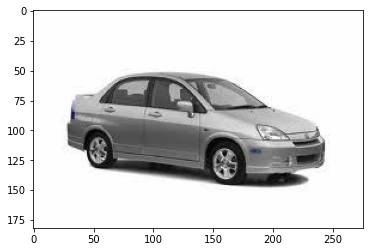

In [ ]:
test_path=car_test_image_details.iloc[0,:]['imagePath']
test_image = cv2.imread(test_path)
plt.imshow(test_image)

In [ ]:
test_image = cv2.resize(test_image, (256,256))
test_image_batch = np.expand_dims(test_image, axis=0)
test_image_prediction = classification_model.predict(test_image_batch)
test_image_prediction

array([[1.2779597e-03, 1.2676005e-03, 2.1965193e-06, 1.1230119e-03,
        1.5071580e-04, 1.0937335e-04, 5.0878287e-03, 3.1894483e-04,
        7.7284680e-04, 3.6158666e-03, 8.6485717e-04, 1.1032572e-02,
        3.3310011e-02, 2.3274003e-02, 1.5984173e-04, 1.8023813e-04,
        3.0008014e-02, 1.7210083e-05, 1.4729383e-05, 2.1756144e-04,
        8.1819494e-04, 2.2711148e-04, 8.1172941e-04, 2.0693738e-05,
        1.2514458e-02, 1.2631192e-05, 5.0312001e-04, 1.5530260e-05,
        3.2503270e-03, 2.0493614e-03, 4.9151331e-03, 3.7755779e-06,
        6.4883282e-04, 2.3743766e-04, 9.5265978e-06, 1.3939065e-03,
        2.6780416e-03, 3.0689174e-04, 3.3540244e-05, 2.1045865e-04,
        1.7572257e-03, 2.3340879e-04, 6.5650762e-05, 2.1548498e-04,
        2.2343316e-03, 1.4816655e-04, 1.0772981e-03, 4.4044663e-04,
        3.9031831e-05, 3.3770760e-07, 1.8840507e-04, 4.3658014e-02,
        1.4143801e-04, 4.9988870e-03, 2.0048693e-04, 1.4442708e-03,
        3.9919214e-03, 4.5615470e-05, 1.1948322e

In [ ]:
np.argmax(test_image_prediction)

108

In [ ]:
car_test_image_details

,Image Name,imagePath,class,height,width,X1,Y1,X2,Y2,Image class
0,00001.jpg,Dataset/Car Images/Test Images/Suzuki Aerio Se...,Suzuki Aerio Sedan 2007,182,276,30,52,246,147,181
1,00002.jpg,Dataset/Car Images/Test Images/Ferrari 458 Ita...,Ferrari 458 Italia Convertible 2012,360,640,100,19,576,203,103
2,00003.jpg,Dataset/Car Images/Test Images/Jeep Patriot SU...,Jeep Patriot SUV 2012,741,1024,51,105,968,659,145
3,00004.jpg,Dataset/Car Images/Test Images/Toyota Camry Se...,Toyota Camry Sedan 2012,480,640,67,84,581,407,187
4,00005.jpg,Dataset/Car Images/Test Images/Tesla Model S S...,Tesla Model S Sedan 2012,373,600,140,151,593,339,185
...,...,...,...,...,...,...,...,...,...,...
8036,08037.jpg,Dataset/Car Images/Test Images/Chevrolet Sonic...,Chevrolet Sonic Sedan 2012,800,1200,49,57,1169,669,63
8037,08038.jpg,Dataset/Car Images/Test Images/Audi V8 Sedan 1...,Audi V8 Sedan 1994,480,640,23,18,640,459,16
8038,08039.jpg,Dataset/Car Images/Test Images/Audi 100 Sedan ...,Audi 100 Sedan 1994,303,635,33,27,602,252,17
8039,08040.jpg,Dataset/Car Images/Test Images/BMW Z4 Converti...,BMW Z4 Convertible 2012,427,640,33,142,521,376,38


Here we can see that image class is coming as 108, but actual one is 181. Let us try with some more test images

In [ ]:
def predict_image_class(test_path):
    image = cv2.imread(test_path)
    image = cv2.resize(image, (256,256))
    test_image_batch = np.expand_dims(image, axis=0)
    test_image_prediction = classification_model.predict(test_image_batch)
    return np.argmax(test_image_prediction)

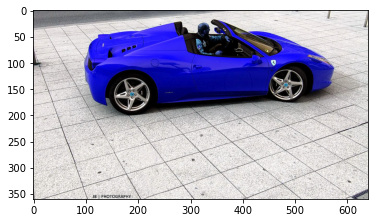

In [ ]:
test_path=car_test_image_details.iloc[1,:]['imagePath']
test_image = cv2.imread(test_path)
plt.imshow(test_image)

In [ ]:
predict_image_class(test_path)

141

In [ ]:
car_test_image_details['Predicted_Image_class']= car_test_image_details['imagePath'].apply(lambda x:predict_image_class(x))

In [ ]:
car_test_image_details

,Image Name,imagePath,class,height,width,X1,Y1,X2,Y2,Image class,Predicted_Image_class
0,00001.jpg,Dataset/Car Images/Test Images/Suzuki Aerio Se...,Suzuki Aerio Sedan 2007,182,276,30,52,246,147,181,108
1,00002.jpg,Dataset/Car Images/Test Images/Ferrari 458 Ita...,Ferrari 458 Italia Convertible 2012,360,640,100,19,576,203,103,141
2,00003.jpg,Dataset/Car Images/Test Images/Jeep Patriot SU...,Jeep Patriot SUV 2012,741,1024,51,105,968,659,145,68
3,00004.jpg,Dataset/Car Images/Test Images/Toyota Camry Se...,Toyota Camry Sedan 2012,480,640,67,84,581,407,187,152
4,00005.jpg,Dataset/Car Images/Test Images/Tesla Model S S...,Tesla Model S Sedan 2012,373,600,140,151,593,339,185,150
...,...,...,...,...,...,...,...,...,...,...,...
8036,08037.jpg,Dataset/Car Images/Test Images/Chevrolet Sonic...,Chevrolet Sonic Sedan 2012,800,1200,49,57,1169,669,63,41
8037,08038.jpg,Dataset/Car Images/Test Images/Audi V8 Sedan 1...,Audi V8 Sedan 1994,480,640,23,18,640,459,16,92
8038,08039.jpg,Dataset/Car Images/Test Images/Audi 100 Sedan ...,Audi 100 Sedan 1994,303,635,33,27,602,252,17,69
8039,08040.jpg,Dataset/Car Images/Test Images/BMW Z4 Converti...,BMW Z4 Convertible 2012,427,640,33,142,521,376,38,20


In [ ]:
car_test_image_details.iloc[11,:]

Image Name                                                       00012.jpg
imagePath                Dataset/Car Images/Test Images/Ford Freestar M...
class                                           Ford Freestar Minivan 2007
height                                                                 194
width                                                                  259
X1                                                                      14
Y1                                                                      21
X2                                                                     242
Y2                                                                     156
Image class                                                            108
Predicted_Image_class                                                  108
Name: 11, dtype: object

In [ ]:
np.where(car_test_image_details['Image class'] == car_test_image_details['Predicted_Image_class'])

(array([  11,  395,  530,  536,  554,  769, 1108, 1389, 1641, 1780, 1946,
        2001, 2005, 2071, 2251, 2318, 2351, 2482, 2504, 3098, 3140, 3141,
        3203, 3222, 3286, 3461, 3595, 3679, 3773, 3825, 3833, 4135, 4156,
        4199, 4221, 4222, 4256, 4291, 4307, 4467, 4629, 4633, 4935, 5078,
        5262, 5335, 5345, 5401, 5483, 5598, 5644, 5882, 6090, 6103, 6112,
        6151, 6201, 6248, 6296, 6353, 6381, 6383, 6450, 6561, 6582, 6678,
        6736, 6751, 6812, 6828, 7284, 7331, 7391, 7509, 7672, 7705, 7710,
        7725, 7726, 7921]),)

We can see that only above rows got predicted correctly. This CNN model is not performing accuratly. We will try with another model now.

## **Object Localization with ResNet as base**

In [ ]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.layers import BatchNormalization , GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.models import Model
from keras.callbacks import EarlyStopping,ModelCheckpoint

In [ ]:
image_size = 224
def data_generator(df, batch_size=32):

    while True:

        image_nums = np.random.randint(0,df.shape[0], size=batch_size)
        batch_images = np.zeros(shape=(batch_size, image_size, image_size, 3))
        batch_labels = np.zeros(shape=(batch_size, len(num_classes)))
        batch_bboxes = np.zeros(shape=(batch_size, 4))
        for i in range(batch_size):
            #Read and resize image
            img = image.load_img(df.loc[image_nums[i], 'imagePath'], target_size=(image_size, image_size))
            img_array = image.img_to_array(img)

            #Update batch
            batch_images[i] = img_array

            #convert image classification label to one hot vector
            cls_label = df.loc[image_nums[i], 'Image class']
            cls_label = to_categorical(cls_label - 1,num_classes=len(num_classes), dtype='float32')
            batch_labels[i] = cls_label

            #Read and resize bounding box co-ordinates
            image_width = df.loc[image_nums[i], 'width']
            image_height = df.loc[image_nums[i], 'height']
            
          
            x1 = data.loc[index[i], 'X1'] * image_size/image_width
            x2 = data.loc[index[i], 'X2'] * image_size/image_width
            y1 = data.loc[index[i], 'Y1'] * image_size/image_height
            y2 = data.loc[index[i], 'Y2'] * image_size/image_height
            batch_bboxes[i] = [x1, y1, x2-x1, y2-y1]

        #Normalize batch images
        for i in range(batch_size):
            batch_images[i] = batch_images[i]/255.0
        
        batch_bboxes = batch_bboxes/image_size

        #Return batch
        yield batch_images, [batch_labels, batch_bboxes]

**Build Model**

In [ ]:
tf.keras.backend.clear_session()
model = ResNet50(include_top=False,input_shape=(image_size, image_size, 3),weights='imagenet')
for layer in model.layers:
    layer.trainable = False

model.summary()

94781440/94765736 [==============================] - 1s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                          

In [ ]:
x = model.output

#Flatten the output to feed to Dense layer
x1 = GlobalAveragePooling2D()(x)
x2 = Dropout(0.5)(x1)
x3 = Dense(200, activation='relu')(x2)
x4 = BatchNormalization()(x3)

#Classification
class_output = Dense(len(num_classes), activation='softmax',name='class')(x4)
#Regression
reg_output = Dense(4,activation='sigmoid',name='reg')(x4)

#with classification and regression
model = Model(inputs=model.input, outputs=[class_output,reg_output])

model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

Evaluation Metric **IOU**

In [ ]:
def calculate_iou(y_true, y_pred):
    results = []
    
    for i in range(0,y_true.shape[0]):
    
        # set the types so we are sure what type we are using
        y_true = np.array(y_true, dtype=np.float32)
        y_pred = np.array(y_pred, dtype=np.float32)
        x_boxTrue_tleft = y_true[i,0]  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]
        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        x_boxPred_tleft = y_pred[i,0]
        y_boxPred_tleft = y_pred[i,1]
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        area_boxPred = (boxPred_width * boxPred_height)

        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.

        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)


        # This must match the type used in py_func
        iou = np.array(iou, dtype=np.float32)
        
        # append the result to a list at the end of each loop
        results.append(iou)
    
    # return the mean IoU score for the batch
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.py_function(calculate_iou, [y_true, y_pred], tf.float32)
    return iou

In [ ]:
# Compile the model
model.compile(optimizer = 'adam', loss={'reg':'mse', 'class':'categorical_crossentropy'},
                               loss_weights={'reg':1, 'class':1},
                               metrics={'reg':[IoU], 'class':['accuracy']})

In [ ]:
#Create train and test generator
batchsize = 224
train_generator = data_generator(car_train_image_details, batch_size=batchsize)
test_generator = data_generator(car_test_image_details, batch_size=batchsize)

earlystop = EarlyStopping(patience=5)
modelsave = ModelCheckpoint( monitor='val_class_accuracy',filepath='./model_resnet.h5', save_best_only=True, verbose=1)



In [ ]:
history = model.fit(train_generator,
                epochs=5,
                steps_per_epoch= car_train_image_details.shape[0]//batchsize,
                validation_data=test_generator,
                validation_steps = car_test_image_details.shape[0]//batchsize,
                callbacks=[earlystop,modelsave])

Epoch 1/5
36/36 [==============================] - ETA: 0s - loss: 5.7279 - class_loss: 5.6010 - reg_loss: 0.1270 - class_accuracy: 0.0058 - reg_IoU: 0.1890 
Epoch 00001: val_class_accuracy improved from -inf to 0.00523, saving model to ./model_resnet.h5
36/36 [==============================] - 2603s 74s/step - loss: 5.7279 - class_loss: 5.6010 - reg_loss: 0.1270 - class_accuracy: 0.0058 - reg_IoU: 0.1890 - val_loss: 5.4432 - val_class_loss: 5.3927 - val_reg_loss: 0.0505 - val_class_accuracy: 0.0052 - val_reg_IoU: 0.3780
Epoch 2/5
36/36 [==============================] - ETA: 0s - loss: 5.5180 - class_loss: 5.4450 - reg_loss: 0.0730 - class_accuracy: 0.0051 - reg_IoU: 0.3229 
Epoch 00002: val_class_accuracy improved from 0.00523 to 0.00702, saving model to ./model_resnet.h5
36/36 [==============================] - 1066s 30s/step - loss: 5.5180 - class_loss: 5.4450 - reg_loss: 0.0730 - class_accuracy: 0.0051 - reg_IoU: 0.3229 - val_loss: 5.3972 - val_class_loss: 5.3683 - val_reg_loss: 0

In [ ]:
5.2954/0.0166

319.0

In [ ]:
# Compile the model
model.compile(optimizer = 'adam', loss={'reg':'mse', 'class':'categorical_crossentropy'},
                               loss_weights={'reg':30, 'class':1},
                               metrics={'reg':[IoU], 'class':['accuracy']})

In [ ]:
history=model.fit(train_generator,
                epochs=50,
                initial_epoch =5,
                steps_per_epoch= car_train_image_details.shape[0]//batchsize,
                validation_data=test_generator,
                validation_steps = car_train_image_details.shape[0]//batchsize,
                callbacks=[earlystop,modelsave])

Epoch 6/50
36/36 [==============================] - ETA: 0s - loss: 5.6959 - class_loss: 5.2799 - reg_loss: 0.0139 - class_accuracy: 0.0097 - reg_IoU: 0.6926
Epoch 00006: val_class_accuracy did not improve from 0.01161
36/36 [==============================] - 187s 5s/step - loss: 5.6959 - class_loss: 5.2799 - reg_loss: 0.0139 - class_accuracy: 0.0097 - reg_IoU: 0.6926 - val_loss: 5.7134 - val_class_loss: 5.2999 - val_reg_loss: 0.0138 - val_class_accuracy: 0.0097 - val_reg_IoU: 0.6969
Epoch 7/50
36/36 [==============================] - ETA: 0s - loss: 5.6224 - class_loss: 5.2514 - reg_loss: 0.0124 - class_accuracy: 0.0113 - reg_IoU: 0.7118
Epoch 00007: val_class_accuracy did not improve from 0.01161
36/36 [==============================] - 168s 5s/step - loss: 5.6224 - class_loss: 5.2514 - reg_loss: 0.0124 - class_accuracy: 0.0113 - reg_IoU: 0.7118 - val_loss: 5.5889 - val_class_loss: 5.2727 - val_reg_loss: 0.0105 - val_class_accuracy: 0.0071 - val_reg_IoU: 0.7197
Epoch 8/50
36/36 [====

In [ ]:
history=model.fit(train_generator,
                epochs=70,
                initial_epoch =38,
                steps_per_epoch= train.shape[0]//batchsize,
                validation_data=test_generator,
                validation_steps = test.shape[0]//batchsize,
                callbacks=[earlystop,modelsave])

Epoch 39/70
36/36 [==============================] - ETA: 0s - loss: 5.1951 - class_loss: 4.8864 - reg_loss: 0.0103 - class_accuracy: 0.0443 - reg_IoU: 0.7371
Epoch 00039: val_class_accuracy did not improve from 0.03329
36/36 [==============================] - 157s 4s/step - loss: 5.1951 - class_loss: 4.8864 - reg_loss: 0.0103 - class_accuracy: 0.0443 - reg_IoU: 0.7371 - val_loss: 5.2854 - val_class_loss: 5.0137 - val_reg_loss: 0.0091 - val_class_accuracy: 0.0315 - val_reg_IoU: 0.7602
Epoch 40/70
36/36 [==============================] - ETA: 0s - loss: 5.1595 - class_loss: 4.8528 - reg_loss: 0.0102 - class_accuracy: 0.0439 - reg_IoU: 0.7405
Epoch 00040: val_class_accuracy did not improve from 0.03329
36/36 [==============================] - 158s 4s/step - loss: 5.1595 - class_loss: 4.8528 - reg_loss: 0.0102 - class_accuracy: 0.0439 - reg_IoU: 0.7405 - val_loss: 5.2700 - val_class_loss: 5.0042 - val_reg_loss: 0.0089 - val_class_accuracy: 0.0293 - val_reg_IoU: 0.7575
Epoch 41/70
36/36 [=

In [ ]:
from keras.models import load_model

model_R = load_model('./model_resnet.h5', custom_objects={"IoU": IoU })

In [ ]:
def predict_image(model,image_num, df):

    #Load image
    img = image.load_img(df.loc[image_num, 'Path'])
    w, h = img.size

    #Prepare input 

    img_resized = img.resize((image_size, image_size))
    input_array = image.img_to_array(img_resized)
    input_array = np.expand_dims(input_array, axis=0)

    input_array = input_array/255.0

    #Prediction
    pred = model.predict(input_array)
    
    label_pred, bbox_pred = pred[0][0], pred[1][0]  
    pred_class = label_class_dict[np.argmax(label_pred)]

    True_class = df.loc[image_num, 'Label']
    xmin, ymin, xmax, ymax = df.loc[image_num, ['xmin', 'ymin', 'xmax', 'ymax']]

    print('Real Label :', True_class, '\nPredicted Label: ', pred_class)
    
    #Draw bounding boxes - Actual (Red) and Predicted(Green)
    img = cv2.imread(df.loc[image_num, 'Path'])
    
    #Draw actual bounding box
    img = cv2.rectangle(img, (xmin, ymin), 
                        (xmax, ymax), (0,0,255), 3)
    
    #Draw predicted bounding box
    img = cv2.rectangle(img, (int(bbox_pred[0]*w), int(bbox_pred[1]*h)), 
                        (int((bbox_pred[0]+bbox_pred[2])*w), int((bbox_pred[1]+bbox_pred[3])*h)), (0,255,0), 3)

    #Display the picture
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.show()

Real Label : Mercedes-Benz C-Class Sedan 2012 
Predicted Label:  Audi V8 Sedan 1994


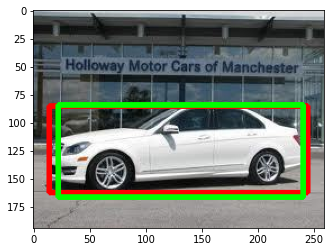

In [ ]:
#Predict on Test Dataset
image_num = np.random.randint(0, test.shape[0])
predict_image(model_R,image_num, test)

# **Tensor Flow Object Detection API**

In [ ]:
Tensor Flow Object Detection API

In [ ]:
#Clone github repo
!git clone https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 67735, done.
remote: Counting objects: 100% (59/59), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 67735 (delta 26), reused 50 (delta 21), pack-reused 67676
Receiving objects: 100% (67735/67735), 576.37 MiB | 18.40 MiB/s, done.
Resolving deltas: 100% (47549/47549), done.
Checking out files: 100% (2935/2935), done.


In [ ]:
#Upgrade pip package
!pip install --upgrade pip

In [ ]:
%%bash
cd models/research
# Compile protos.
protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
cp object_detection/packages/tf2/setup.py .
python -m pip install --use-feature=2020-resolver .

Processing /content/drive/My Drive/AIML/CapStone/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1680866 sha256=583ad239902d8435dac4a89382c905821a491d2e6197f4702f646356311ae95e
  Stored in directory: /tmp/pip-ephem-wheel-cache-t1aa3kqu/wheels/bb/5c/a6/2a195e2ac5f727b1cbeccc14afb41f516a926f5a0853a31dfd
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22258 sha256=4d59ed3cf1b092852f93c5c87af6e75933c78fe7c0a2640c97ff7562d60eff59
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for avro-python3: filename=avro_python3-1.9.2.1-py3-none-any.whl size=43512 sha256=a5dfffadfac6022d8ec0f12975c4d86e0455fb61ffd64c321ed79cb4b214958d
  Stored in directory: /root/.cache/pip/wheels/bc/49/5f/fdb5b9d85055c478213e0158ac122b596816149a02d82e0ab1
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78546 sha256=ee962045535465c18313

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.26.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
#Check for Object Detection API
!pip list | grep object-detection

object-detection              0.1


In [ ]:
!mkdir detection

In [ ]:
#Go to the project folder
%cd detection

/content/drive/My Drive/AIML/CapStone/detection


In [ ]:
!cp '/content/drive/MyDrive/AIML/CapStone/test_df_final.csv' .
!cp '/content/drive/MyDrive/AIML/CapStone/train_df_final.csv' .

Tensorflow object detection API requires data in tfrecord format. This can be done using generate_tfrecord.py file.

The script file requires 3 inputs

--csv_input= : where is csv file located which was prepared in previous step

--img_path= : where are the actual images stored

--output_path= : where the script can save the generated tfrecord file and what should be file name.
We will run script for training and test csv separately to create two tfrecord files.

In [ ]:
#generate tfrecord for training data
!python generate_tfrecord.py --csv_input=train_df_final.csv --img_path='/content/drive/MyDrive/AIML/CapStone/Car Images/Train Images' --output_path=train.tfrecord

Successfully created the TFRecords: /content/drive/MyDrive/AIML/CapStone/detection/train.tfrecord


In [ ]:
#generate tfrecord for training data
!python generate_tfrecord.py --csv_input=test_df_final.csv --img_path="/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images" --output_path=test.tfrecord

Successfully created the TFRecords: /content/drive/MyDrive/AIML/CapStone/detection/test.tfrecord


In [ ]:
ls -l

total 1952296
-rw-r--r-- 1 root root      4465 Nov 29 17:17 generate_tfrecord.py
-rw------- 1 root root    817611 Nov 29 17:16 test_df_final.csv
-rw-r--r-- 1 root root 998145296 Nov 29 17:18 test.tfrecord
-rw------- 1 root root    828263 Nov 29 17:16 train_df_final.csv
-rw-r--r-- 1 root root 999335395 Nov 29 17:17 train.tfrecord


In [ ]:
#Build a pbtxt label file using label and class name
#This is required by Object detection API

pbtxt_file_txt = ''
for label in sorted(label_class_dict.keys()):    
    pbtxt_file_txt += "item {\n  id: " + str(label) + "\n  name: '" +  label_class_dict[label] + "'\n}\n\n"

with open('label_map.txt','w') as pbfile:
    pbfile.write(pbtxt_file_txt)

In [ ]:
!cat label_map.txt

item {
  id: 1
  name: 'AM General Hummer SUV 2000'
}

item {
  id: 2
  name: 'Acura RL Sedan 2012'
}

item {
  id: 3
  name: 'Acura TL Sedan 2012'
}

item {
  id: 4
  name: 'Acura TL Type-S 2008'
}

item {
  id: 5
  name: 'Acura TSX Sedan 2012'
}

item {
  id: 6
  name: 'Acura Integra Type R 2001'
}

item {
  id: 7
  name: 'Acura ZDX Hatchback 2012'
}

item {
  id: 8
  name: 'Aston Martin V8 Vantage Convertible 2012'
}

item {
  id: 9
  name: 'Aston Martin V8 Vantage Coupe 2012'
}

item {
  id: 10
  name: 'Aston Martin Virage Convertible 2012'
}

item {
  id: 11
  name: 'Aston Martin Virage Coupe 2012'
}

item {
  id: 12
  name: 'Audi RS 4 Convertible 2008'
}

item {
  id: 13
  name: 'Audi A5 Coupe 2012'
}

item {
  id: 14
  name: 'Audi TTS Coupe 2012'
}

item {
  id: 15
  name: 'Audi R8 Coupe 2012'
}

item {
  id: 16
  name: 'Audi V8 Sedan 1994'
}

item {
  id: 17
  name: 'Audi 100 Sedan 1994'
}

item {
  id: 18
  name: 'Audi 100 Wagon 1994'
}

item {
  id: 19
  name: 'Audi TT Hatchb

 TensorFlow model zoo.
 https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

In [ ]:
#download model from zoo
#!wget http://download.tensorflow.org/models/object_detection/ssd_mobilenet_v2_coco_2018_03_29.tar.gz
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
#!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
#!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
#Extract tar file content
#!tar -xf ssd_mobilenet_v2_coco_2018_03_29.tar.gz
!tar -xf ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
#!tar -xf ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
#!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz

Prepare Training configuration file

Change num_classes parameter to 196 

For 'train_input_reader' change 'input_path' to filepath of train.record file.

For 'train_input_reader' change 'label_map_path' to filepath of label_map.txt file.

Repeat above two steps for 'eval_input_reader'.

Change fine_tune_checkpoint to filepath 

Change 'batch_size' accordingly to available memory.

Change 'num_steps' to indicate how long the training will done e.g. 200000. 

sample config files are available at
models/research/object_detection/samples/configs

In [ ]:
#config_file = 'ssd_mobilenet_v2_coco.config'
config_file = 'ssd_mobilenet_v2_modified.config'

In [ ]:
#Copy training file from 'models/research/object_detection' folder to current folder
!cp /content/drive/MyDrive/AIML/CapStone/models/research/object_detection/model_main_tf2.py .

In [ ]:
ls -l

total 2047137
drwx------ 2 root root      4096 Dec  3 12:57 detection_model/
-rw------- 1 root root      9635 Dec  3 12:57 export_inference_graph.py
-rw------- 1 root root      4465 Dec  1 10:24 generate_tfrecord.py
-rw------- 1 root root     11226 Dec  1 12:04 label_map.txt
-rw------- 1 root root      4937 Dec  1 13:30 model_main_tf2.py
drwx------ 9 root root      4096 Dec  3 16:01 models/
drwx------ 2 root root      4096 Dec  3 13:16 SSD_CAR_TF1/
drwx------ 2 root root      4096 May 10  2018 ssdlite_mobilenet_v2_coco_2018_05_09/
-rw------- 1 root root  51025348 May 10  2018 ssdlite_mobilenet_v2_coco_2018_05_09.tar.gz
-rw------- 1 root root      4649 Dec  3 04:49 ssdlite_mobilenet_v2_coco.config
drwx------ 2 root root      4096 Jul 11  2020 ssd_mobilenet_v2_320x320_coco17_tpu-8/
-rw------- 1 root root  46042990 Jul 11  2020 ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
-rw------- 1 root root      4720 Dec  3 04:22 ssd_mobilenet_v2_coco.config
-rw------- 1 root root    817611 Dec  1 10:

In [ ]:
!mkdir training-tf2

In [ ]:
#start training
!python model_main_tf2.py --model_dir=training-tf2/ --pipeline_config_path={config_file} --checkpoint_every_n=5000 --alsologtostderr

2021-12-04 14:24:26.897561: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1204 14:24:26.904639 139938174281600 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I1204 14:24:26.909887 139938174281600 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1204 14:24:26.910071 139938174281600 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W1204 14:24:26.949319 139938174281600 deprecation.py:347] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:558: StrategyBase.experiment

In [ ]:
#start Evaluation
!python model_main_tf2.py --model_dir=training-tf2/ --pipeline_config_path={config_file} --checkpoint_dir=training-tf2/ --alsologtostderr 

W1204 15:52:21.369666 140211212756864 model_lib_v2.py:1082] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1204 15:52:21.369937 140211212756864 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1204 15:52:21.370029 140211212756864 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1204 15:52:21.370115 140211212756864 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1204 15:52:21.370238 140211212756864 model_lib_v2.py:1103] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-12-04 15:52:22.088196: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original confi

In [ ]:
#Copy exporter file from models/research/object_detection to current directory
!cp /content/drive/MyDrive/AIML/CapStone/models/research/object_detection/exporter_main_v2.py .

#Provide input name, config file location, training folder
!python exporter_main_v2.py --input_type "image_tensor" --pipeline_config_path {config_file} --trained_checkpoint_dir training-tf2/ --output_directory detection_model

2021-12-04 16:34:09.192557: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1204 16:34:09.504186 139852151719808 deprecation.py:619] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:464: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
#Check if model is saved in current directory
!ls -l detection_model/saved_model

total 14159
drwx------ 2 root root     4096 Dec  3 19:12 assets
-rw------- 1 root root 14490075 Dec  4 16:36 saved_model.pb
drwx------ 2 root root     4096 Dec  4 16:36 variables


In [ ]:
!mkdir SSD_CAR_TF2

!cp -r detection_model '/content/drive/MyDrive/AIML/CapStone/SSD_CAR_TF2' 

import pickle

file_path = '/content/drive/MyDrive/AIML/CapStone/SSD_CAR_TF2/label_class_dict.pkl'

with open(file_path,'wb') as file:
    pickle.dump(label_class_dict, file)

In [ ]:
import tensorflow as tf
saved_model_path = 'detection_model/saved_model'
model = tf.saved_model.load(saved_model_path)

In [ ]:
#Function to get predictions from a Detection model
def detector_prediction(image_file, confidence_threshold=0.5):
    #Load image
    img = tf.keras.preprocessing.image.load_img(image_file)
    
    #Convert to numpy array
    img_array = tf.keras.preprocessing.image.img_to_array(img).astype('uint8')
    #Make it a batch of one example
    img_array = tf.expand_dims(img_array, axis=0)

    #Prediction
    output = model(img_array) #get list of tensors discussed above as output
    #print(output)
    detection_scores = output['detection_scores'].numpy()[0] #get detection scores
    detection_classes = output['detection_classes'].numpy()[0]
    detection_boxes = output['detection_boxes'].numpy()[0]
    #print(detection_scores)
    #Select predictions for which probability is higher than confidence_threshold
    selected_predictions = detection_scores >= confidence_threshold
    #print(selected_predictions)
    selected_prediction_scores = detection_scores[selected_predictions]
    selected_prediction_classes = detection_classes[selected_predictions]
    selected_prediction_boxes = detection_boxes[selected_predictions]

    #De-normalize box co-ordinates (multiply x-coordinates by image width and y-coords by image height)
    img_w, img_h = img.size

    for i in range(selected_prediction_boxes.shape[0]):
        
        selected_prediction_boxes[i,0] *= img_h #ymin * img_w
        selected_prediction_boxes[i,1] *= img_w #xmin * img_h
        selected_prediction_boxes[i,2] *= img_h #ymax * img_w
        selected_prediction_boxes[i,3] *= img_w #xmax * img_h

    #Make all co-ordinates as integer
    selected_prediction_boxes= selected_prediction_boxes.astype(int)

    #Convert class indexes to actual class labels
    predicted_classes = []
    for i in range(selected_prediction_classes.shape[0]):
        predicted_classes.append(label_class_dict[int(selected_prediction_classes[i])])

    #Number of predictions
    selected_num_predictions = selected_prediction_boxes.shape[0]

    return {'Total Predictions': selected_num_predictions,
            'Scores': selected_prediction_scores, 
            'Classes': predicted_classes, 
            'Box coordinates': selected_prediction_boxes}

Visualize model output

In [ ]:
def visualize_output(image_file, confidence_threshold=0.5):

    #Call model prediction function above
    output = detector_prediction(image_file, confidence_threshold=confidence_threshold)

    #Read image
    img = cv2.imread(image_file)

    #Draw rectangle for predicted boxes, also add predicted classes
    for i in range(output['Box coordinates'].shape[0]):

        box = output['Box coordinates'][i]
        
        #Draw rectangle - (ymin, xmin, ymax, xmax)
        img = cv2.rectangle(img, (box[1], box[0]), (box[3], box[2]), (0,255,0), 2)
        
        #Add Label - Class name and confidence level
        label = output['Classes'][i] + ': ' + str(round(output['Scores'][i],2))
        img = cv2.putText(img, label, (box[1], box[0]-10), cv2.FONT_HERSHEY_TRIPLEX, 0.8, (255,255,255), 1,cv2.LINE_AA)
    
    #Conver BGR image to RGB to use with Matplotlib
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    #Display image
    plt.figure(figsize=(10,6))
    plt.imshow(img)
    plt.show()

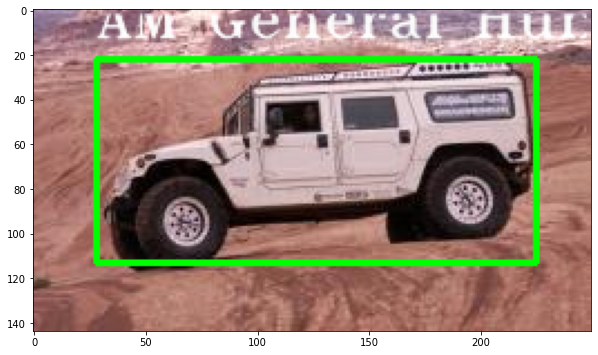

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/AM General Hummer SUV 2000/00457.jpg',0.5)

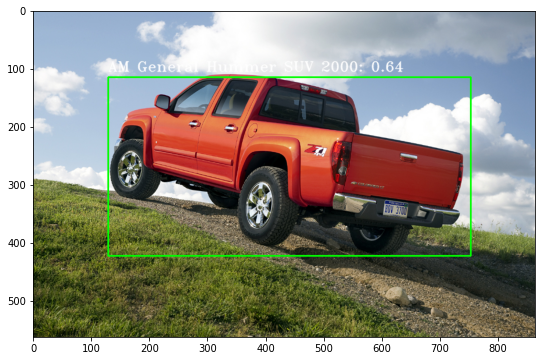

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/HUMMER H3T Crew Cab 2010/00414.jpg',0.5)

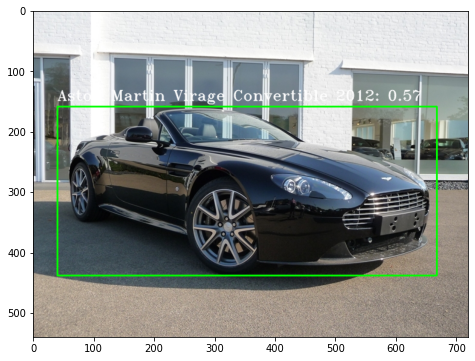

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Aston Martin V8 Vantage Convertible 2012/00239.jpg',0.5)

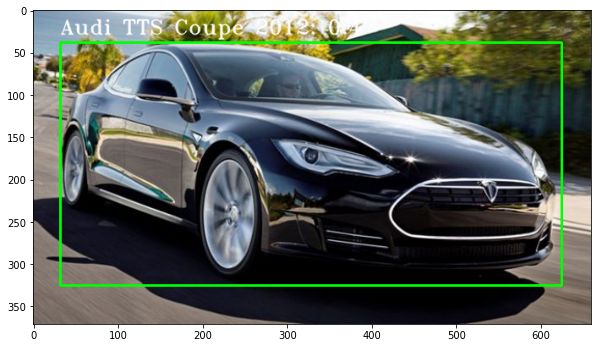

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Tesla Model S Sedan 2012/07174.jpg',0.37)

total_loss for the trained model settled at 1.471968

This can be improved by adjusting hyper parameters and train for more number of epoches.

Modified the Base Learning rate & warmup learning rate in the config file and proceeding with model training

# **TUNING MODEL**

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir training

<IPython.core.display.Javascript object>

In [ ]:
#start training
!python model_main_tf2.py --model_dir=training-tf2/ --pipeline_config_path={config_file} --checkpoint_every_n=5000 --alsologtostderr

2021-12-14 03:09:23.171866: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1214 03:09:23.182441 139776706635648 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I1214 03:09:23.190571 139776706635648 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1214 03:09:23.190738 139776706635648 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W1214 03:09:23.251730 139776706635648 deprecation.py:347] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experiment

In [ ]:
#start Evaluation
!python model_main_tf2.py --model_dir=training-tf2/ --pipeline_config_path={config_file} --checkpoint_dir=training-tf2/ --alsologtostderr 

W1214 03:30:07.316207 140432208299904 model_lib_v2.py:1090] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1214 03:30:07.316444 140432208299904 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1214 03:30:07.316531 140432208299904 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1214 03:30:07.316615 140432208299904 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1214 03:30:07.316729 140432208299904 model_lib_v2.py:1111] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-12-14 03:30:08.025013: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original confi

Below are the best results after 190000 epcohes.

      Detection Boxes_Precision/mAP: 0.821089

      Detection Boxes_Precision/mAP@.50IOU: 0.907789

      Detection Boxes_Precision/mAP@.75IOU: 0.900015

      Loss/localization_loss: 0.017242 

      Loss/classification_loss: 0.212154 

      Loss/regularization_loss: 0.123719 

      Loss/total_loss: 0.353114

model trained on custom cars dataset using SSD mobilenet achieved mAP of 90% at 0.75 IOU.

In [ ]:
#Copy exporter file from models/research/object_detection to current directory
!cp /content/drive/MyDrive/AIML/CapStone/models/research/object_detection/exporter_main_v2.py .

#Provide input name, config file location, training folder
!python exporter_main_v2.py --input_type "image_tensor" --pipeline_config_path {config_file} --trained_checkpoint_dir training-tf2/ --output_directory detection_model

2021-12-14 03:53:49.087638: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1214 03:53:49.363723 140617253775232 deprecation.py:619] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:464: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

In [ ]:
#Check if model is saved in current directory
!ls -l detection_model/saved_model

total 14159
drwx------ 2 root root     4096 Dec  3 19:12 assets
-rw------- 1 root root 14490075 Dec 14 03:55 saved_model.pb
drwx------ 2 root root     4096 Dec 14 03:55 variables


In [ ]:
!cp -r detection_model '/content/drive/MyDrive/AIML/CapStone/SSD_CAR_TF2' 

import pickle

file_path = '/content/drive/MyDrive/AIML/CapStone/SSD_CAR_TF2/label_class_dict.pkl'

with open(file_path,'wb') as file:
    pickle.dump(label_class_dict, file)

In [ ]:
import tensorflow as tf
saved_model_path = 'detection_model/saved_model'
tuned_model = tf.saved_model.load(saved_model_path)

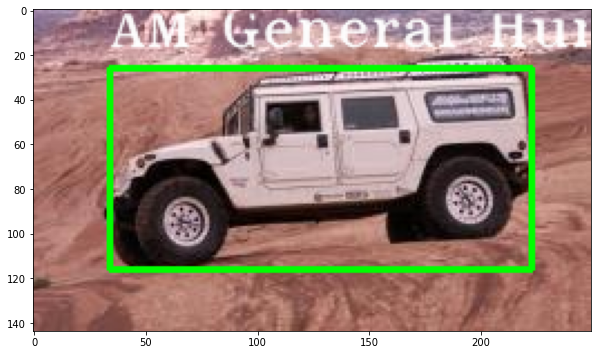

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/AM General Hummer SUV 2000/00457.jpg',0.9)

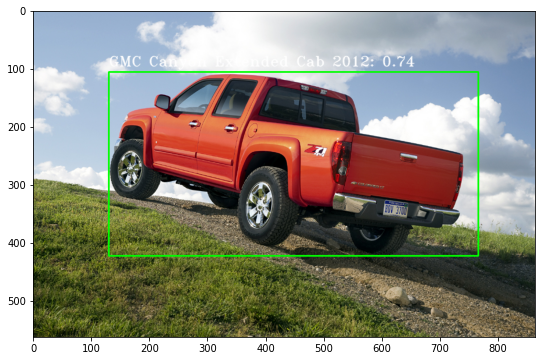

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/HUMMER H3T Crew Cab 2010/00414.jpg',0.5)

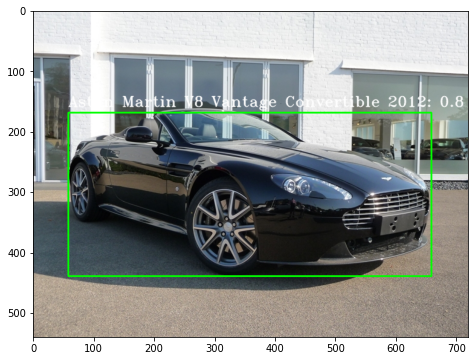

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Aston Martin V8 Vantage Convertible 2012/00239.jpg',0.5)

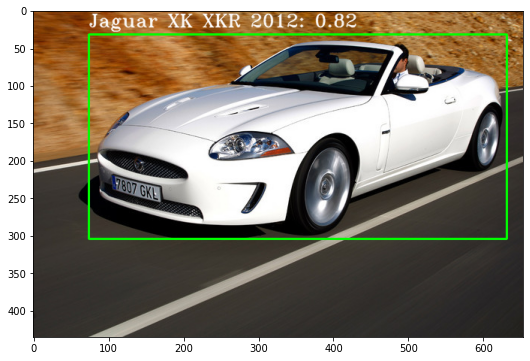

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Jaguar XK XKR 2012/00897.jpg')

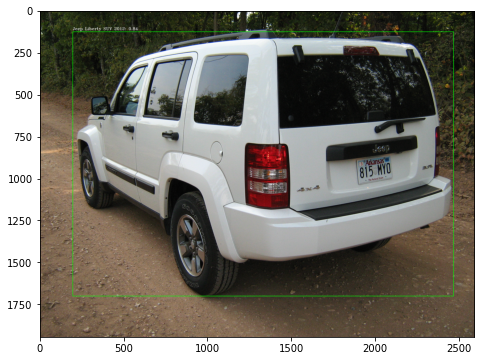

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Jeep Liberty SUV 2012/00293.jpg')

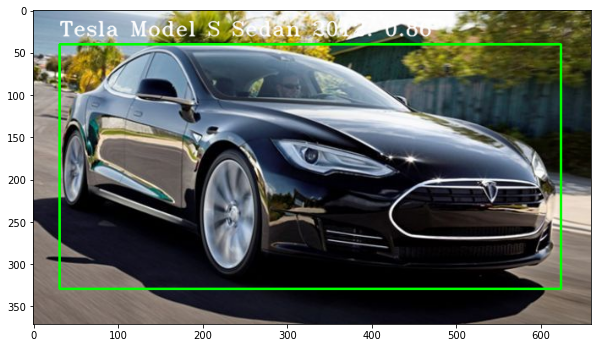

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Tesla Model S Sedan 2012/07174.jpg')

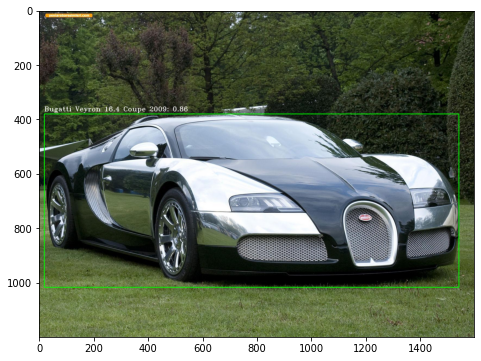

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Bugatti Veyron 16.4 Coupe 2009/02126.jpg')

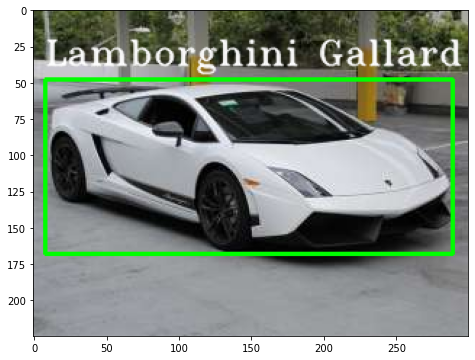

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Lamborghini Gallardo LP 570-4 Superleggera 2012/02170.jpg')

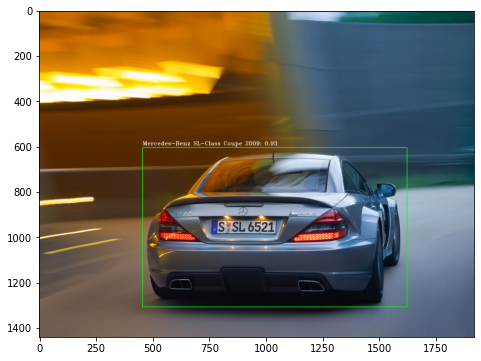

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Mercedes-Benz SL-Class Coupe 2009/02240.jpg')

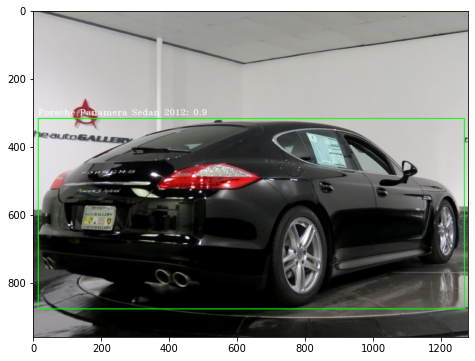

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Porsche Panamera Sedan 2012/00399.jpg')

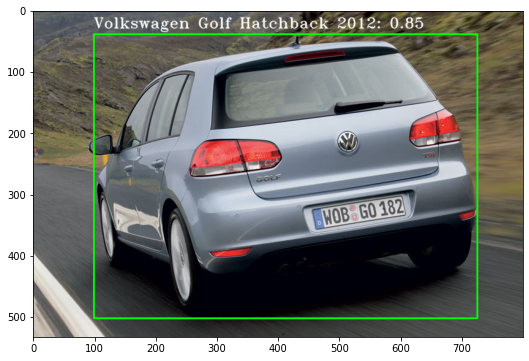

In [ ]:
visualize_output('/content/drive/MyDrive/AIML/CapStone/Car Images/Test Images/Volkswagen Golf Hatchback 2012/01310.jpg')

# **FLASK MODEL**

Exported model from tf2 is saved in the path : models/detection_model/saved_model

We have 2 pages for web aplication : Login and Home along with prediction.

Requirement:
Have to create a folder named uploads to store the uplaoded images for predcition.

Static folder contains images and CSS files. 
Located in https://github.com/girijeshcse/autovision/tree/main/static

HTML Pages are located in below path:
https://github.com/girijeshcse/autovision/tree/main/templates



In [ ]:
from flask import Flask, render_template, request, redirect, url_for, send_from_directory
from werkzeug.utils import secure_filename
import numpy as np
import os
import sys
import pandas as pd
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
#import models
import pickle
import os

sys.path.append("..")

# from utils import visualization_utils as vis_util
print('current path:',os.getcwd())
saved_model_path = 'models/detection_model/saved_model'
model = tf.saved_model.load(saved_model_path)
label_class_dict = pickle.load(open('label_class_dict.pkl', 'rb'))

app = Flask(__name__,template_folder='templates')
app.config['UPLOAD_FOLDER'] = 'uploads/'
app.config['ALLOWED_EXTENSIONS'] = set(['png', 'jpg', 'jpeg'])


def allowed_file(filename):
    return '.' in filename and \
           filename.rsplit('.', 1)[1] in app.config['ALLOWED_EXTENSIONS']


#@app.route('/')
def index():
    return render_template('index.html')

@app.route('/')
def login():
    return render_template("login.html")
database={'yafar':'123','vijay':'123','prasad':'123','Preetika':'123','jayshima':'123'}

@app.route('/form_login',methods=['POST','GET'])
def form_login():
    name1=request.form['username']
    pwd=request.form['password']
    if name1 not in database:
        return render_template('login.html',info='Invalid User')
    else:
        if database[name1]!=pwd:
            return render_template('login.html',info='Invalid Password')
        else:
            return render_template('home.html',name=name1)

@app.route('/upload', methods=['POST'])
def upload():
    file = request.files['file']
    if file and allowed_file(file.filename):
        filename = secure_filename(file.filename)
        file.save(os.path.join(app.config['UPLOAD_FOLDER'], filename))
        return redirect(url_for('uploaded_file',
                                filename=filename))

def detector_prediction(image_file, confidence_threshold=0.5):
    #Load image
    img = tf.keras.preprocessing.image.load_img(image_file)
    
    #Convert to numpy array
    img_array = tf.keras.preprocessing.image.img_to_array(img).astype('uint8')
    #Make it a batch of one example
    img_array = tf.expand_dims(img_array, axis=0)

    #Prediction
    output = model(img_array) #get list of tensors discussed above as output
    #print(output)
    detection_scores = output['detection_scores'].numpy()[0] #get detection scores
    detection_classes = output['detection_classes'].numpy()[0]
    detection_boxes = output['detection_boxes'].numpy()[0]
    #print(detection_scores)
    #Select predictions for which probability is higher than confidence_threshold
    selected_predictions = detection_scores >= confidence_threshold
    #print(selected_predictions)
    selected_prediction_scores = detection_scores[selected_predictions]
    selected_prediction_classes = detection_classes[selected_predictions]
    selected_prediction_boxes = detection_boxes[selected_predictions]

    #De-normalize box co-ordinates (multiply x-coordinates by image width and y-coords by image height)
    img_w, img_h = img.size

    for i in range(selected_prediction_boxes.shape[0]):
        
        selected_prediction_boxes[i,0] *= img_h #ymin * img_w
        selected_prediction_boxes[i,1] *= img_w #xmin * img_h
        selected_prediction_boxes[i,2] *= img_h #ymax * img_w
        selected_prediction_boxes[i,3] *= img_w #xmax * img_h

    #Make all co-ordinates as integer
    selected_prediction_boxes= selected_prediction_boxes.astype(int)

    #Convert class indexes to actual class labels
    predicted_classes = []
    for i in range(selected_prediction_classes.shape[0]):
        predicted_classes.append(label_class_dict[int(selected_prediction_classes[i])])

    #Number of predictions
    selected_num_predictions = selected_prediction_boxes.shape[0]

    return {'Total Predictions': selected_num_predictions,
            'Scores': selected_prediction_scores, 
            'Classes': predicted_classes, 
            'Box coordinates': selected_prediction_boxes}

@app.route('/uploads/<filename>')
def uploaded_file(filename):
    PATH_TO_TEST_IMAGES_DIR = app.config['UPLOAD_FOLDER']
    TEST_IMAGE_PATHS = [os.path.join(PATH_TO_TEST_IMAGES_DIR, filename.format(i)) for i in range(1, 2)]

    for image_file in TEST_IMAGE_PATHS:
        
        #Call model prediction function above
        output = detector_prediction(image_file, confidence_threshold=0.5)

        #Read image
        img = cv2.imread(image_file)

        #Draw rectangle for predicted boxes, also add predicted classes
        for i in range(output['Box coordinates'].shape[0]):

            box = output['Box coordinates'][i]
            
            #Draw rectangle - (ymin, xmin, ymax, xmax)
            img = cv2.rectangle(img, (box[1], box[0]), (box[3], box[2]), (0,0,255), 2)
            
            #Add Label - Class name and confidence level
            label = output['Classes'][i] + ': ' + str(round(output['Scores'][i],2))
            img = cv2.putText(img, label, (box[1], box[0]-10), cv2.FONT_HERSHEY_TRIPLEX, 0.8, (255,255,255), 1,cv2.LINE_AA)
        
        #Conver BGR image to RGB to use with Matplotlib
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        im = Image.fromarray(img)
        im.save('uploads/' + filename)

    return send_from_directory(app.config['UPLOAD_FOLDER'],
                               filename)

if __name__ == "__main__":
    app.run(debug=True)

Home page is shown as below with Team information and "**choose File**" Option to predict image

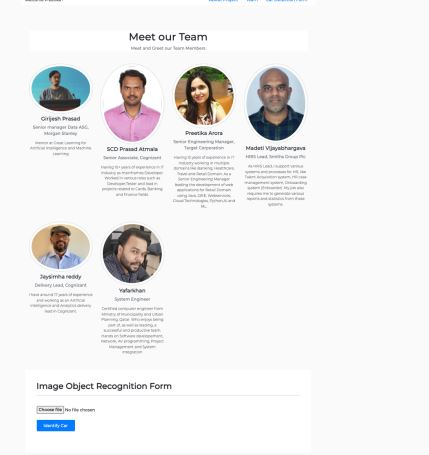

Once the image is uploaded, Preview can be seen as below

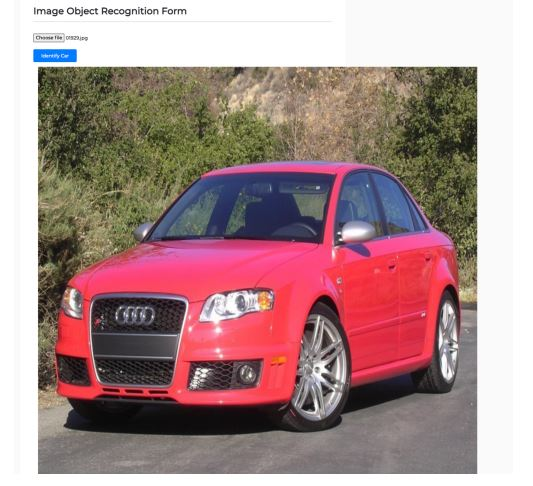

Images are classified within bounding box are shown as below upon clicking **identify car** Button.

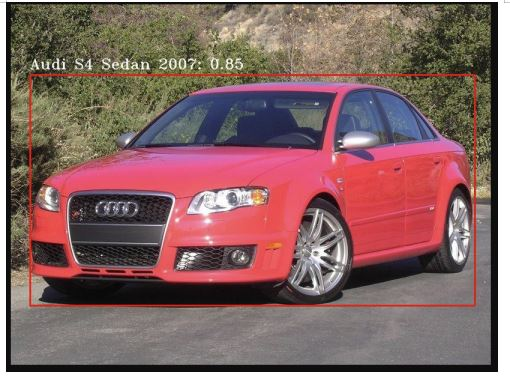